In [155]:
import sys
sys.path.insert(0, '/home/ading/dev/empirical-mt')
sys.path.insert(0, '/home/ading/dev/pyflow/')

import matplotlib.pyplot as plt

from pelic.gabors import makeGabors, makeGaussian
from pelic.calculate_contrast import CalculateContrast

import pandas as pd

from tqdm import tqdm 

from tuning import DirectionTuning, SpeedTuning, DisparityTuning

import numpy as np

from skimage import io, transform, util, img_as_float, img_as_ubyte
from skimage.color import rgb2gray, gray2rgb
from skimage.transform import resize
import skimage.draw as draw

import scipy.io as sio

import MT

from keras.layers import Input, Dense, Concatenate, Multiply
from keras.models import Model

size_ = 101
gabors = makeGabors(size_, center=None)
gaussian = makeGaussian(size_, sigma=5, center=None)

contrast_calculator = CalculateContrast(gabors, gaussian)

import tensorflow as tf

from os import listdir
from os.path import isfile, join, split, isdir, basename

from scipy import stats

import cv2
import pyflow

In [159]:
d = '../data/alov300++/pairwise_train_frac1_size76_ratio0.5_grayscale'

df = pd.read_json('../data/alov300++/pairwise_train_frac1_size76_ratio0.5_grayscale/index.json')

In [135]:
df.shape

(10705, 6)

In [164]:
def flow_avg(r):
    prev_frame_filepath = join(d, r['feature_dir'], 'prev_frame.png')
    frame_filepath = join(d, r['feature_dir'], 'frame.png')
    
    prev_frame = io.imread(prev_frame_filepath, as_gray=True)
    frame = io.imread(frame_filepath, as_gray=True)

    prev_frame_u8 = img_as_ubyte(prev_frame)
    frame_u8 = img_as_ubyte(frame)
    opt_flow_farneback = cv2.calcOpticalFlowFarneback(prev_frame_u8, frame_u8, flow=None, pyr_scale=0.5, levels=4, winsize=15, iterations=3, poly_n=5, poly_sigma=1.1, flags=0)
    h = opt_flow_farneback[:, :, 1]
    v = opt_flow_farneback[:, :, 0]
    
    in_mask = np.zeros((76, 76))
    rr, cc = draw.rectangle(r['box1'][0], r['box2'][1])
    in_mask[rr, cc] = 1.
    
    out_mask = np.ones((76, 76))
    out_mask[rr, cc] = 0.
    
    return pd.Series({'fx_in': np.divide(np.sum(np.multiply(h, in_mask)), np.sum(in_mask)),
                      'fx_out': np.divide(np.sum(np.multiply(h, out_mask)), np.sum(out_mask)), 
                      'fy_in': np.divide(np.sum(np.multiply(v, in_mask)), np.sum(in_mask)),
                      'fy_out': np.divide(np.sum(np.multiply(v, out_mask)), np.sum(out_mask))})


    
    

In [137]:
df = df.loc[df['video_category'] == 'light']

In [138]:
df.shape

(901, 6)

In [165]:
df2 = df.merge(df.apply(flow_avg, axis=1), left_index=True, right_index=True)

In [140]:
df2.head()

,box1,box2,feature_dir,frame_id,video_category,video_id,fx_in,fx_out,fy_in,fy_out
37,"[[19, 26], [57, 51]]","[[15, 24], [52, 49]]",01-Light_video00016/00000324,324,light,01-Light_video00016,-0.316471,-1.830519,-0.447768,-2.394686
42,"[[19, 23], [57, 53]]","[[10, 22], [47, 51]]",01-Light_video00026/00000066,66,light,01-Light_video00026,-0.614446,-2.792329,-0.001248,0.114091
72,"[[20, 24], [57, 52]]","[[20, 24], [57, 52]]",01-Light_video00005/00000061,61,light,01-Light_video00005,0.075515,0.340238,0.034897,-0.157687
73,"[[20, 24], [57, 52]]","[[20, 24], [57, 52]]",01-Light_video00005/00000146,146,light,01-Light_video00005,0.052296,-0.135296,-0.199058,-1.632839
77,"[[20, 32], [57, 44]]","[[22, 28], [59, 41]]",01-Light_video00033/00000405,405,light,01-Light_video00033,0.001467,-0.032914,-0.053595,-0.362803


In [166]:
df2['offset_v1_x'] = df2.apply(lambda r: (np.array(r['box2']) - np.array(r['box1']))[0, 0], axis = 1) 
df2['offset_v1_y'] = df2.apply(lambda r: (np.array(r['box2']) - np.array(r['box1']))[0, 1], axis = 1)

df2['offset_v2_x'] = df2.apply(lambda r: (np.array(r['box2']) - np.array(r['box1']))[1, 0], axis = 1) 
df2['offset_v2_y'] = df2.apply(lambda r: (np.array(r['box2']) - np.array(r['box1']))[1, 1], axis = 1) 

In [100]:
df2.head()

,box1,box2,feature_dir,frame_id,video_category,video_id,fx_in,fx_out,fy_in,fy_out,offset_v1_x,offset_v1_y,offset_v2_x,offset_v2_y
37,"[[19, 26], [57, 51]]","[[15, 24], [52, 49]]",01-Light_video00016/00000324,324,light,01-Light_video00016,-0.300582,-1.231202,-0.456151,-1.491989,-4,-2,-5,-2
42,"[[19, 23], [57, 53]]","[[10, 22], [47, 51]]",01-Light_video00026/00000066,66,light,01-Light_video00026,-0.315090,-1.315483,0.141090,0.991855,-9,-1,-10,-2
72,"[[20, 24], [57, 52]]","[[20, 24], [57, 52]]",01-Light_video00005/00000061,61,light,01-Light_video00005,0.081324,0.097330,0.035409,-1.670292,0,0,0,0
73,"[[20, 24], [57, 52]]","[[20, 24], [57, 52]]",01-Light_video00005/00000146,146,light,01-Light_video00005,0.104708,-0.791996,-0.086862,-2.804163,0,0,0,0
77,"[[20, 32], [57, 44]]","[[22, 28], [59, 41]]",01-Light_video00033/00000405,405,light,01-Light_video00033,0.041370,0.047587,-0.133665,-0.218493,2,-4,2,-3


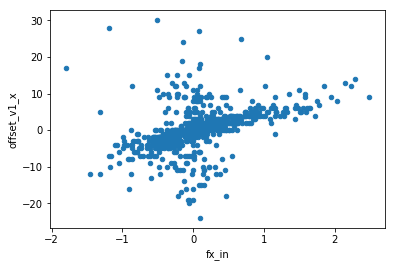

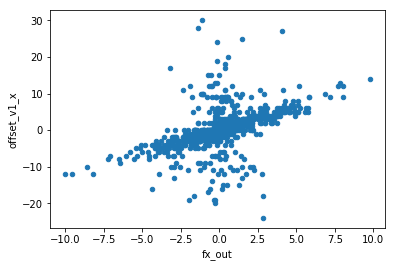

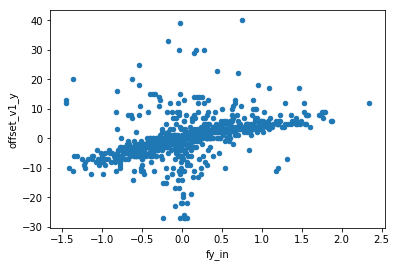

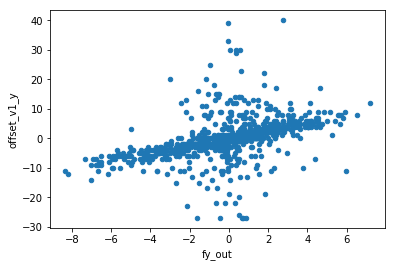

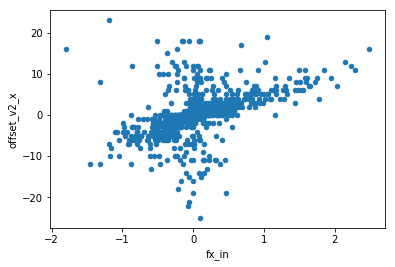

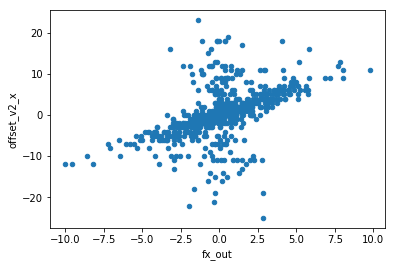

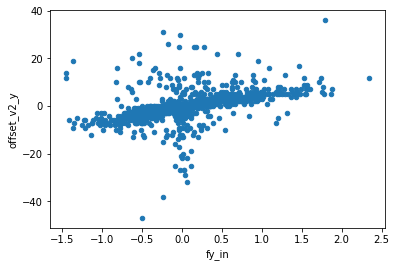

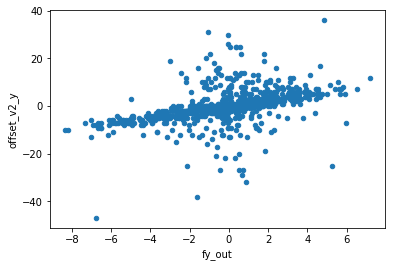

In [143]:
plt.figure(figsize=(10, 10))


df2.plot.scatter(x='fx_in', y='offset_v1_x')

#plt.subplot(2, 2, 2)
df2.plot.scatter(x='fx_out', y='offset_v1_x')

#plt.subplot(2, 2, 3)
df2.plot.scatter(x='fy_in', y='offset_v1_y')

#plt.subplot(2, 2, 4)
df2.plot.scatter(x='fy_out', y='offset_v1_y')


df2.plot.scatter(x='fx_in', y='offset_v2_x')

#plt.subplot(2, 2, 2)
df2.plot.scatter(x='fx_out', y='offset_v2_x')

#plt.subplot(2, 2, 3)
df2.plot.scatter(x='fy_in', y='offset_v2_y')

#plt.subplot(2, 2, 4)
df2.plot.scatter(x='fy_out', y='offset_v2_y')
# plt.show()

In [87]:
df2.shape

(266, 14)

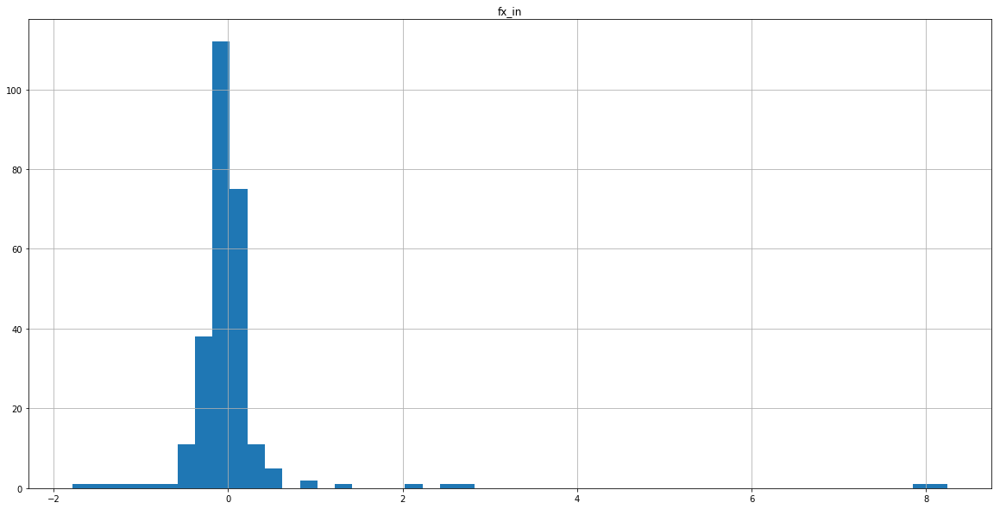

In [88]:
plt.figure(figsize=(30, 30))

pd.DataFrame.hist(df2, column='fx_in', bins=50, figsize=(20, 10))

plt.show()

(array([  1.00000000e+00,   0.00000000e+00,   0.00000000e+00,
          0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
          0.00000000e+00,   0.00000000e+00,   3.00000000e+00,
          2.00000000e+00,   7.00000000e+00,   6.00000000e+00,
          1.20000000e+01,   1.20000000e+01,   3.20000000e+01,
          4.00000000e+01,   4.50000000e+01,   5.80000000e+01,
          8.80000000e+01,   1.19000000e+02,   1.81000000e+02,
          2.51000000e+02,   4.04000000e+02,   6.51000000e+02,
          1.34100000e+03,   4.15100000e+03,   1.46400000e+03,
          5.95000000e+02,   3.67000000e+02,   2.41000000e+02,
          1.66000000e+02,   1.33000000e+02,   9.50000000e+01,
          8.10000000e+01,   4.40000000e+01,   3.90000000e+01,
          2.30000000e+01,   1.50000000e+01,   1.90000000e+01,
          4.00000000e+00,   2.00000000e+00,   4.00000000e+00,
          2.00000000e+00,   2.00000000e+00,   0.00000000e+00,
          0.00000000e+00,   2.00000000e+00,   1.00000000e+00,
        

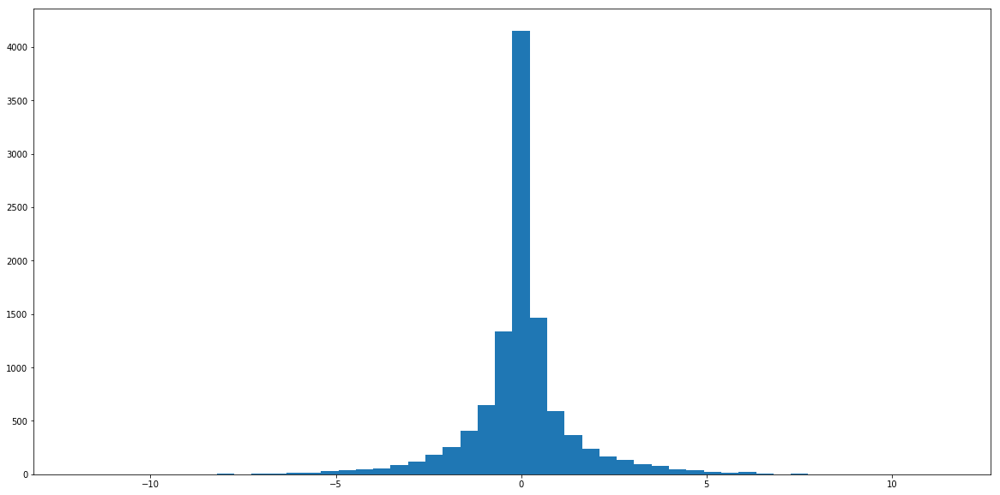

In [58]:
plt.figure(figsize=(20, 10))

plt.hist(df2['fx_in'].values + df2['fx_out'].values, bins=50)

In [167]:
from sklearn.linear_model import LinearRegression

m = LinearRegression()

m.fit(X=df2[['fx_in', 'fx_out', 'fy_in', 'fy_out']], y=df2[['offset_v1_x', 'offset_v1_y', 'offset_v2_x', 'offset_v2_y']])

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=1, normalize=False)

In [168]:
train_p_offset = m.predict(df2[['fx_in', 'fx_out', 'fy_in', 'fy_out']])

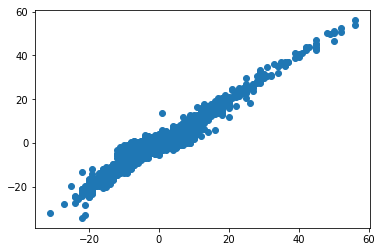

In [172]:
plt.scatter(df2['offset_v1_x'], df2['offset_v1_x'] - train_p_offset[:, 0])

In [32]:
v1_x = np.stack(df2['box1'])[:, 0, 0]

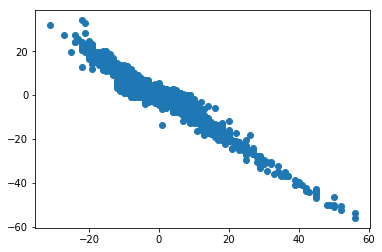

In [173]:
plt.scatter(df2['offset_v1_x'], train_p_offset[:, 0] - df2['offset_v1_x'])


# X = np.linspace(-20,20,100)
# plt.scatter(X, X, marker='.')

In [174]:
df2['v1_x_error'] = pd.Series(np.abs(train_p_offset[:, 0] - df2['offset_v1_x']), index=df2.index)

In [175]:
df2.sort_values(by='v1_x_error', ascending=False).iloc[1:10]

,box1,box2,feature_dir,frame_id,video_category,video_id,fx_in,fx_out,fy_in,fy_out,offset_v1_x,offset_v1_y,offset_v2_x,offset_v2_y,v1_x_error
6049,"[[19, 19], [58, 58]]","[[75, 71], [75, 75]]",06-MotionSmoothness_video00004/00000075,75,motionsmoothness,06-MotionSmoothness_video00004,0.330862,2.392485,-1.248009,-3.014404,56,52,17,17,53.823992
5832,"[[19, 19], [57, 57]]","[[71, 68], [75, 75]]",14-LongDuration_video00001/00000732,732,longduration,14-LongDuration_video00001,-0.195298,-0.315493,-0.118793,4.250782,52,49,18,18,52.546853
4846,"[[20, 20], [57, 57]]","[[70, 1], [75, 40]]",14-LongDuration_video00001/00000534,534,longduration,14-LongDuration_video00001,-2.342926,-0.615823,0.675767,-2.456453,50,-19,18,-17,50.997246
1470,"[[19, 19], [57, 57]]","[[71, 26], [75, 63]]",14-LongDuration_video00001/00000514,514,longduration,14-LongDuration_video00001,2.988266,0.829273,-3.742350,-0.530156,52,7,18,6,50.619568
8494,"[[20, 23], [57, 54]]","[[68, 20], [75, 54]]",06-MotionSmoothness_video00018/00000081,81,motionsmoothness,06-MotionSmoothness_video00018,-3.035538,-1.610311,1.697172,2.435640,48,-3,18,0,50.230471
6784,"[[19, 19], [57, 57]]","[[69, 12], [75, 42]]",06-MotionSmoothness_video00022/00000166,166,motionsmoothness,06-MotionSmoothness_video00022,-0.203048,-0.212473,2.250036,-0.520935,50,-7,18,-15,50.080920
1832,"[[22, 20], [55, 57]]","[[71, 0], [75, 15]]",12-MovingCamera_video00021/00000270,270,movingcamera,12-MovingCamera_video00021,-2.412101,-0.245148,-0.305030,0.661290,49,-20,20,-42,49.932799
5104,"[[19, 21], [57, 55]]","[[64, 8], [75, 43]]",11-Occlusion_video00003/00000041,41,occlusion,11-Occlusion_video00003,-3.050420,-1.769089,4.240409,0.037429,45,-13,18,-12,47.103715
10062,"[[20, 19], [56, 57]]","[[70, 13], [75, 52]]",07-MotionCoherence_video00010/00000048,48,motioncoherence,07-MotionCoherence_video00010,-1.243920,4.524963,-1.848666,-0.598172,50,-6,19,-5,46.678315


In [156]:
# Flow Options:
alpha = 0.012
ratio = 0.75
minWidth = 20
nOuterFPIterations = 7
nInnerFPIterations = 1
nSORIterations = 30
colType = 1  # 0 or default:RGB, 1:GRAY (but pass gray image with shape (h,w,1))


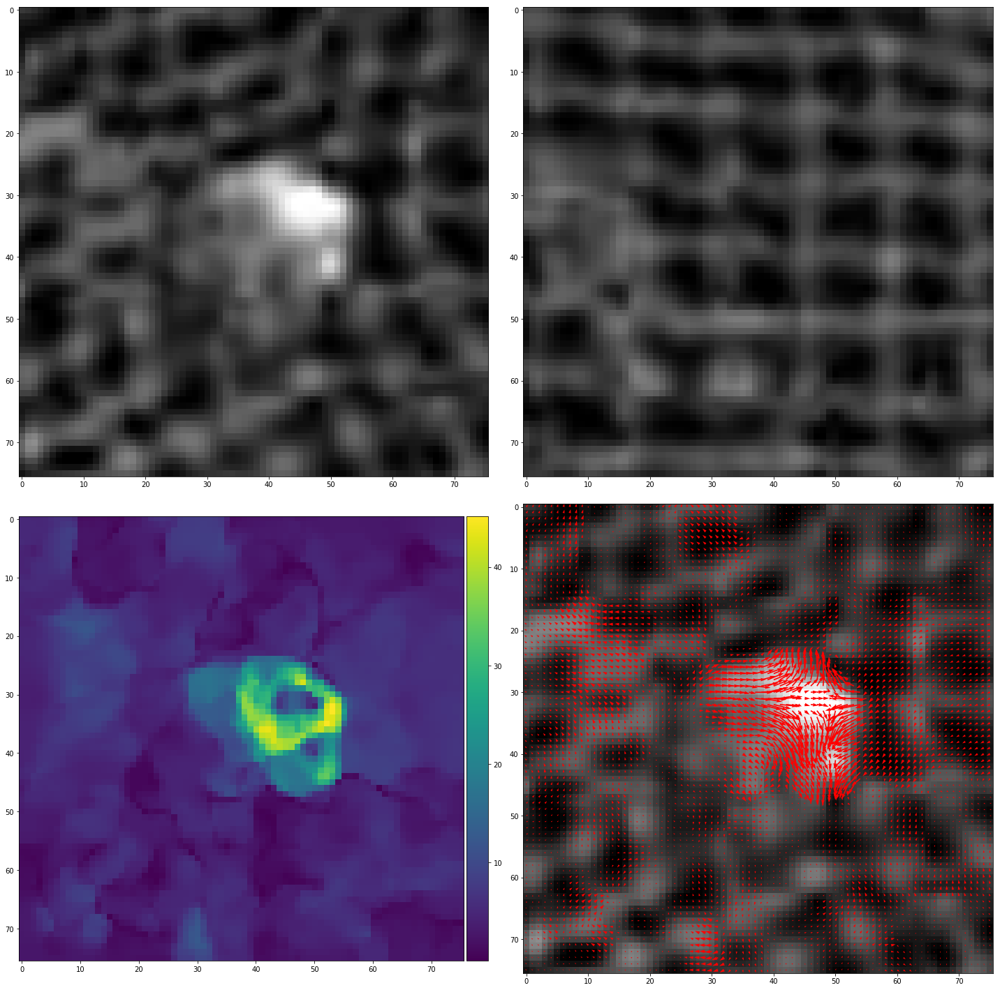

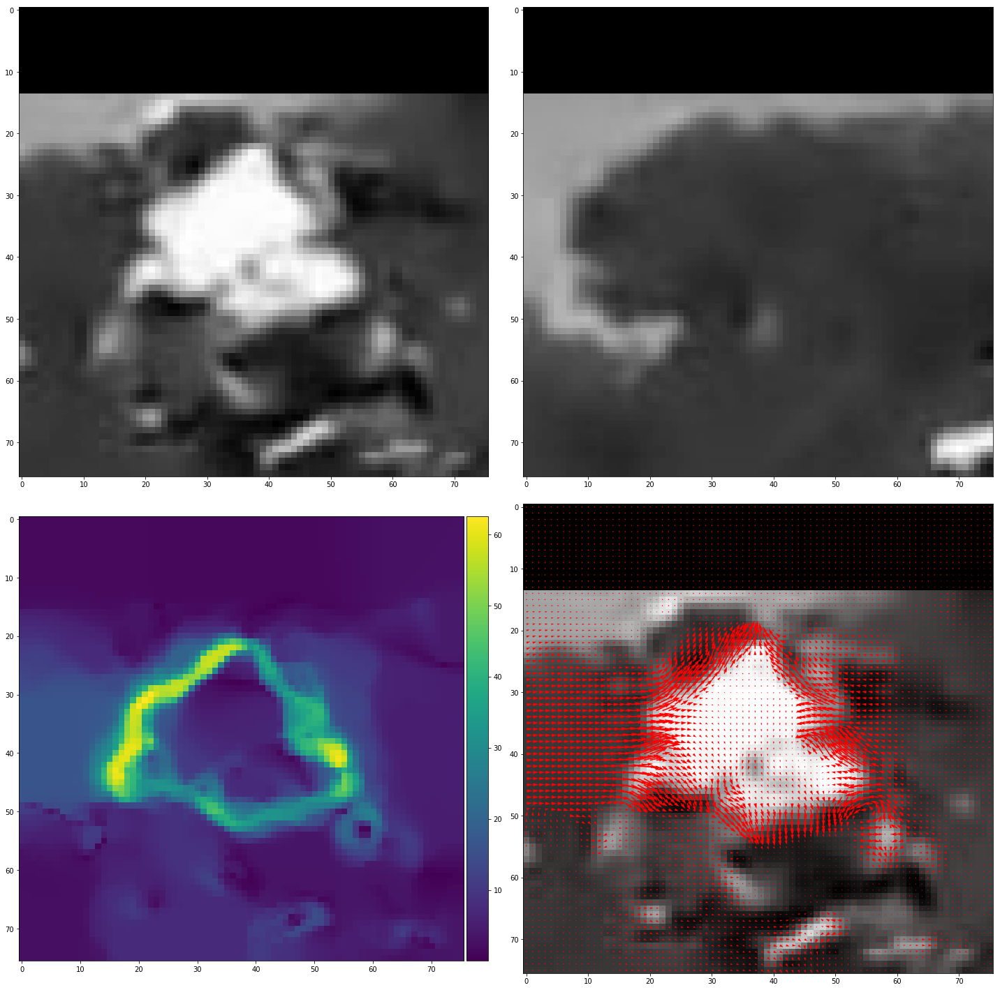

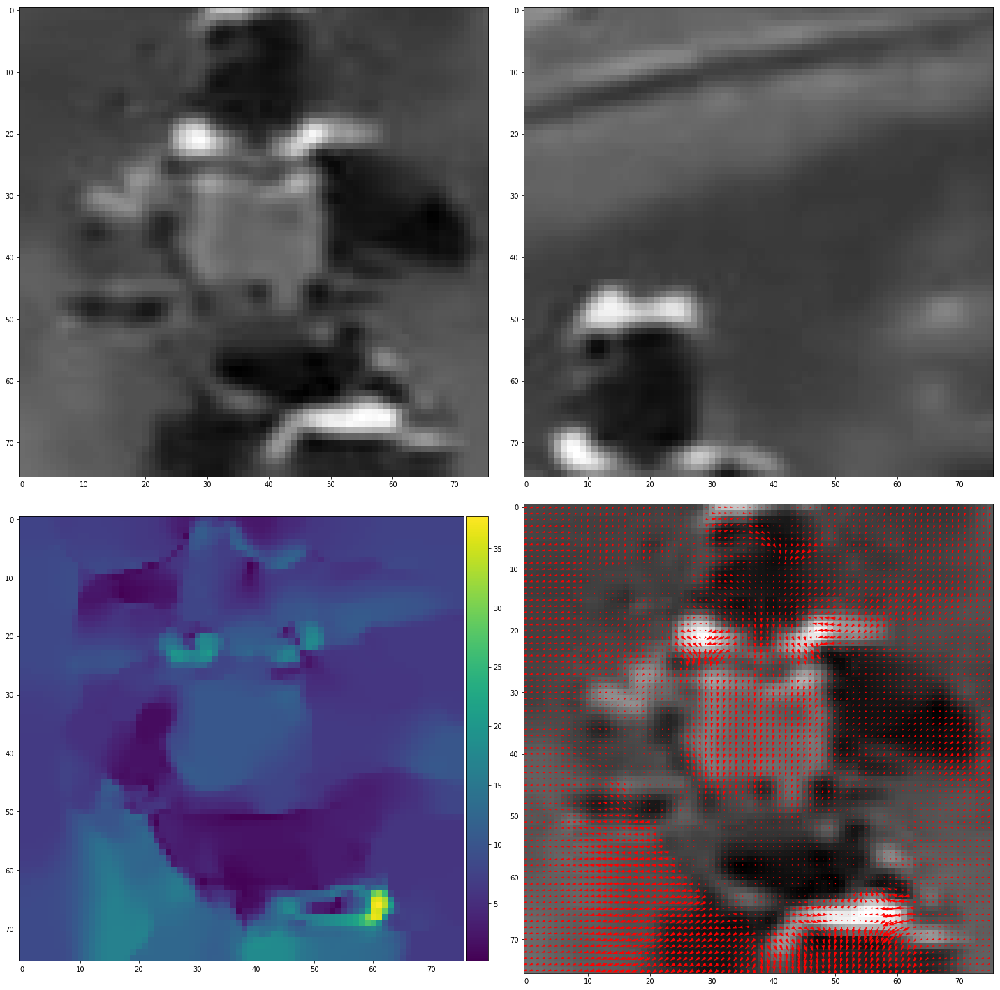

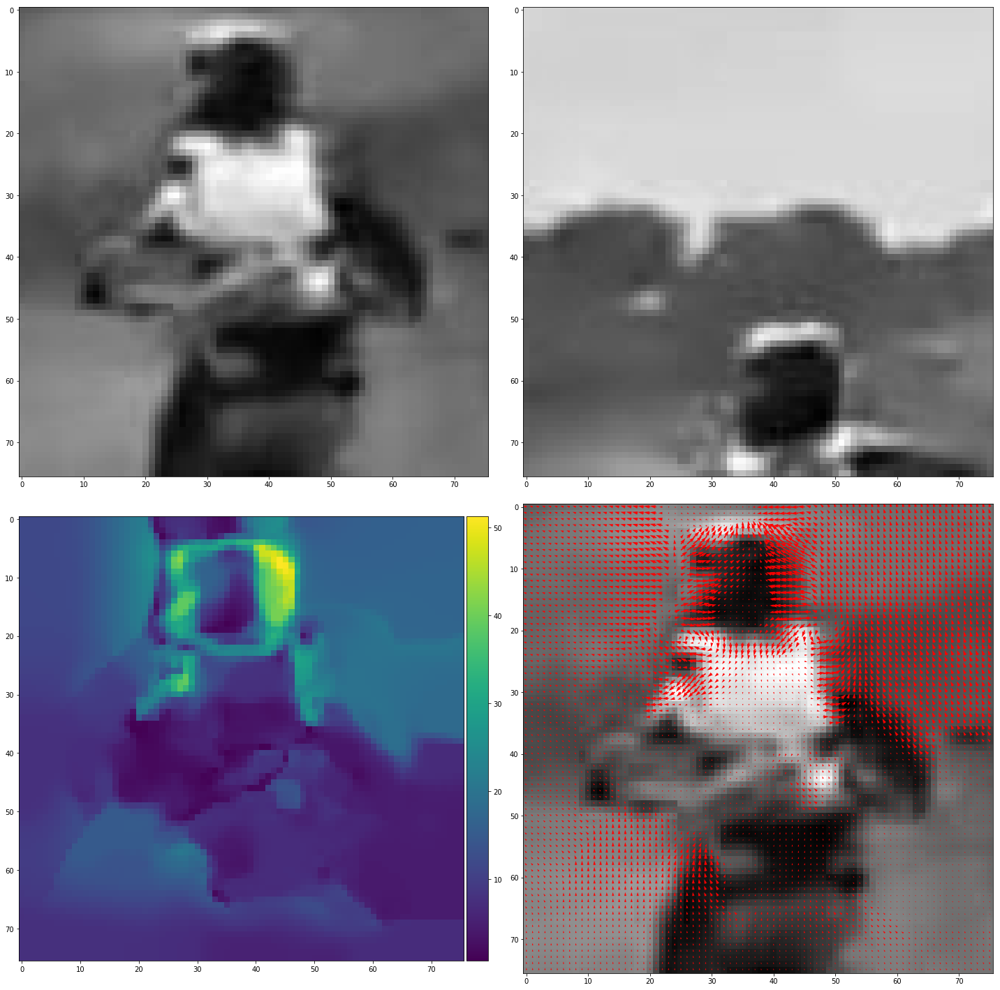

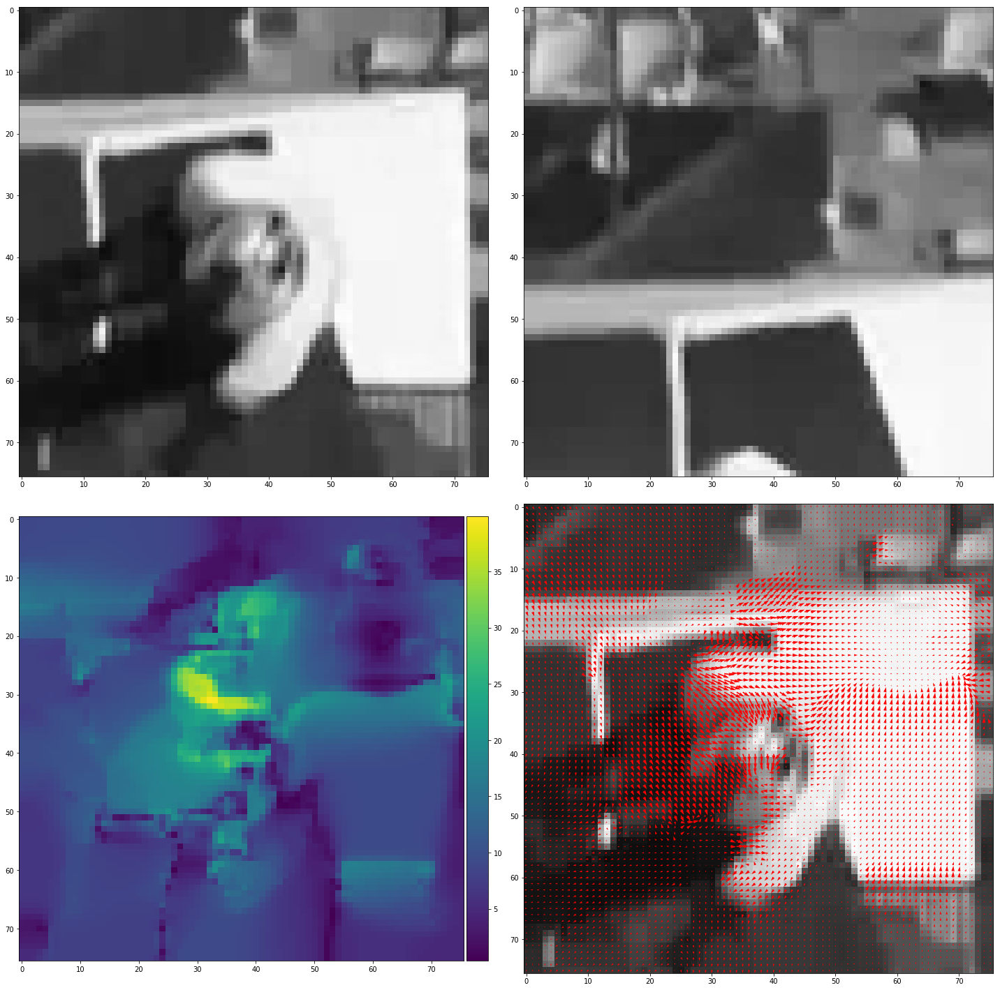

...

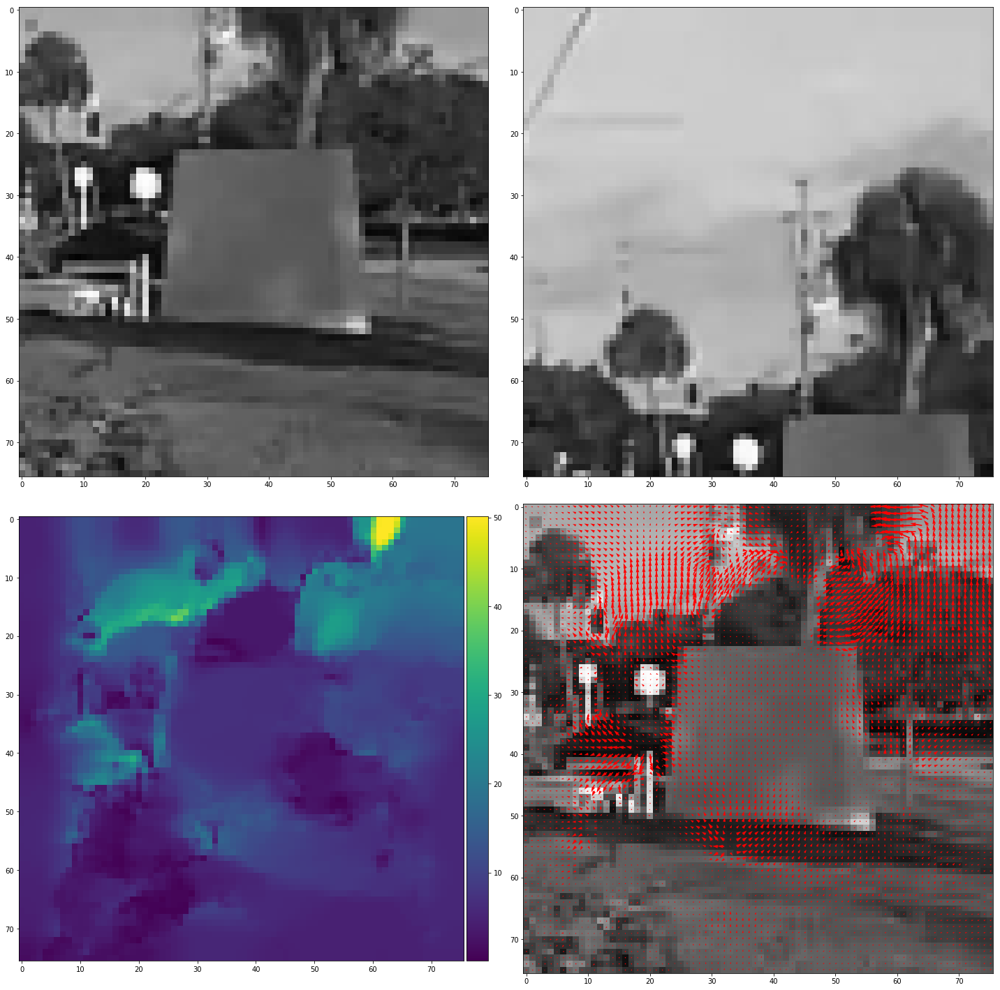

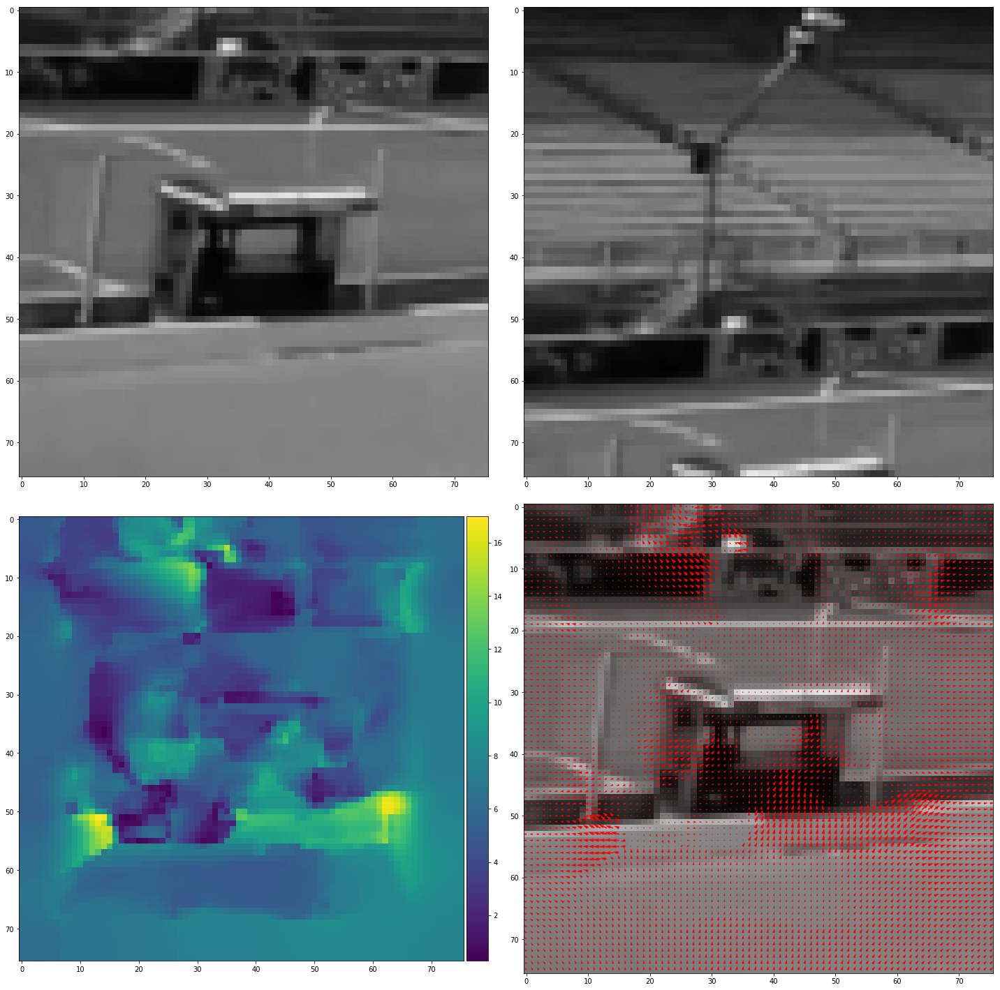

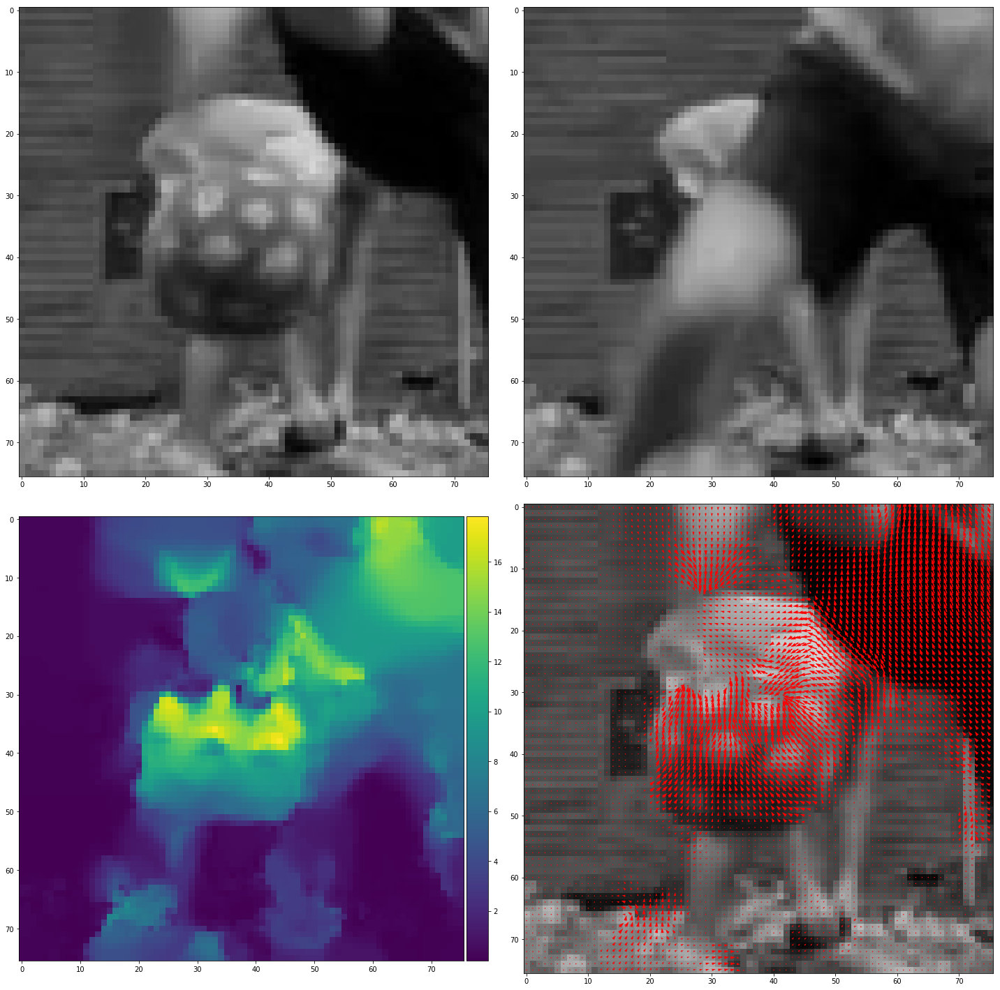

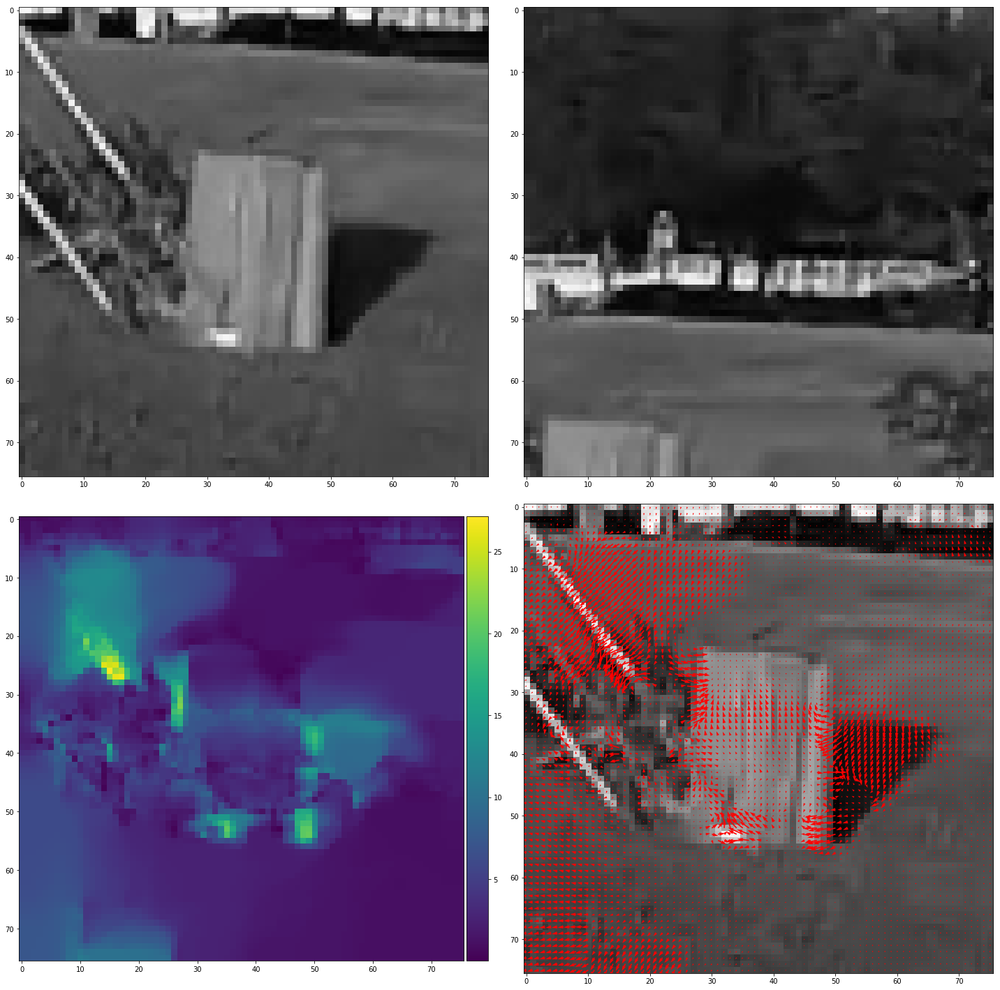

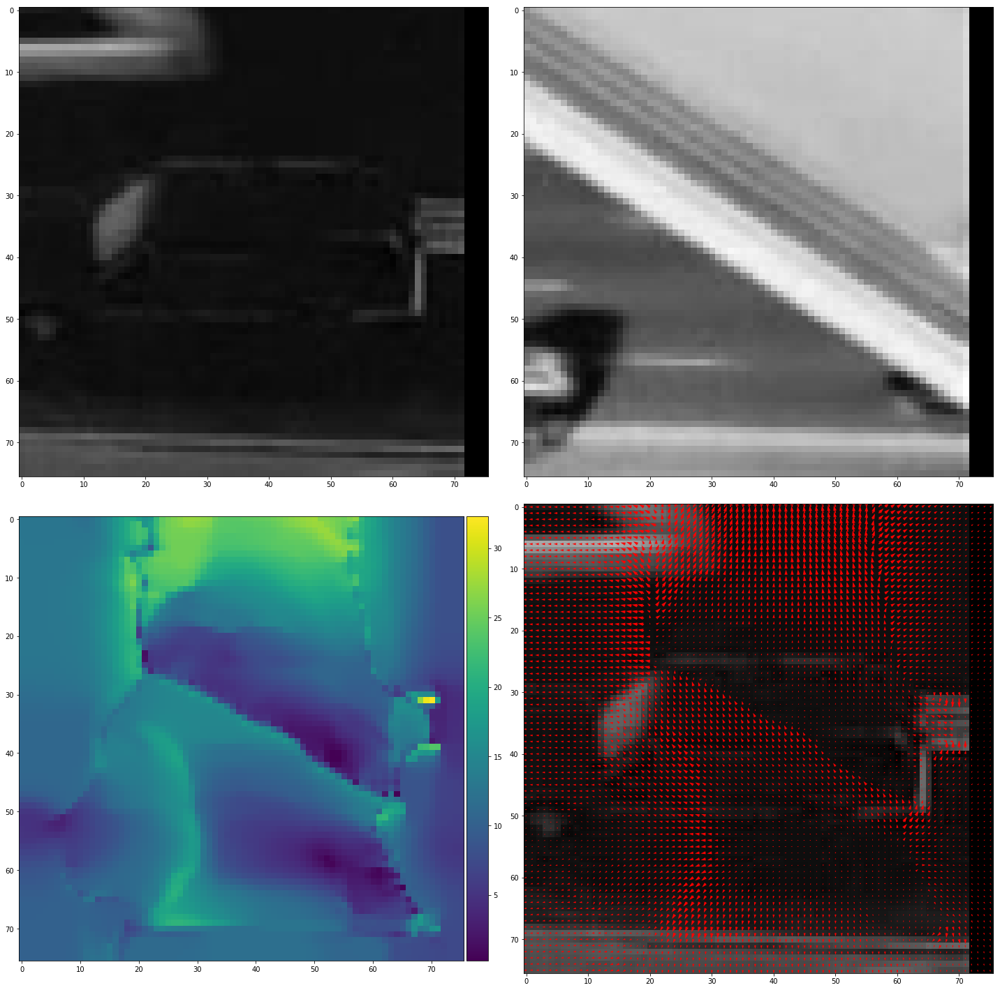

In [178]:
for _, r in df2.sort_values(by='v1_x_error', ascending=False).iloc[1:20].iterrows():
    plt.figure(figsize=(20, 20))
    
    f1_path = join(d, r['feature_dir'], 'prev_frame.png')
    f2_path = join(d, r['feature_dir'], 'frame.png')
    
    plt.subplot(2, 2, 1)
    prev_frame = io.imread(f1_path)
    io.imshow(prev_frame)
    
    plt.subplot(2, 2, 2)
    frame = io.imread(f2_path)
    io.imshow(frame)
    
    prev_frame_f = np.expand_dims(img_as_float(prev_frame), axis=2)
    frame_f = np.expand_dims(img_as_float(frame), axis=2)
    
    u, v, im2W = pyflow.coarse2fine_flow(
    prev_frame_f, frame_f, alpha, ratio, minWidth, nOuterFPIterations, nInnerFPIterations,
    nSORIterations, colType)
    
    plt.subplot(2, 2, 3)
    io.imshow(np.sqrt(np.square(u) + np.square(v)))
    
    plt.subplot(2, 2, 4)
    io.imshow(prev_frame)
    plt.quiver(u, v, color='r')
    
    plt.show()
    

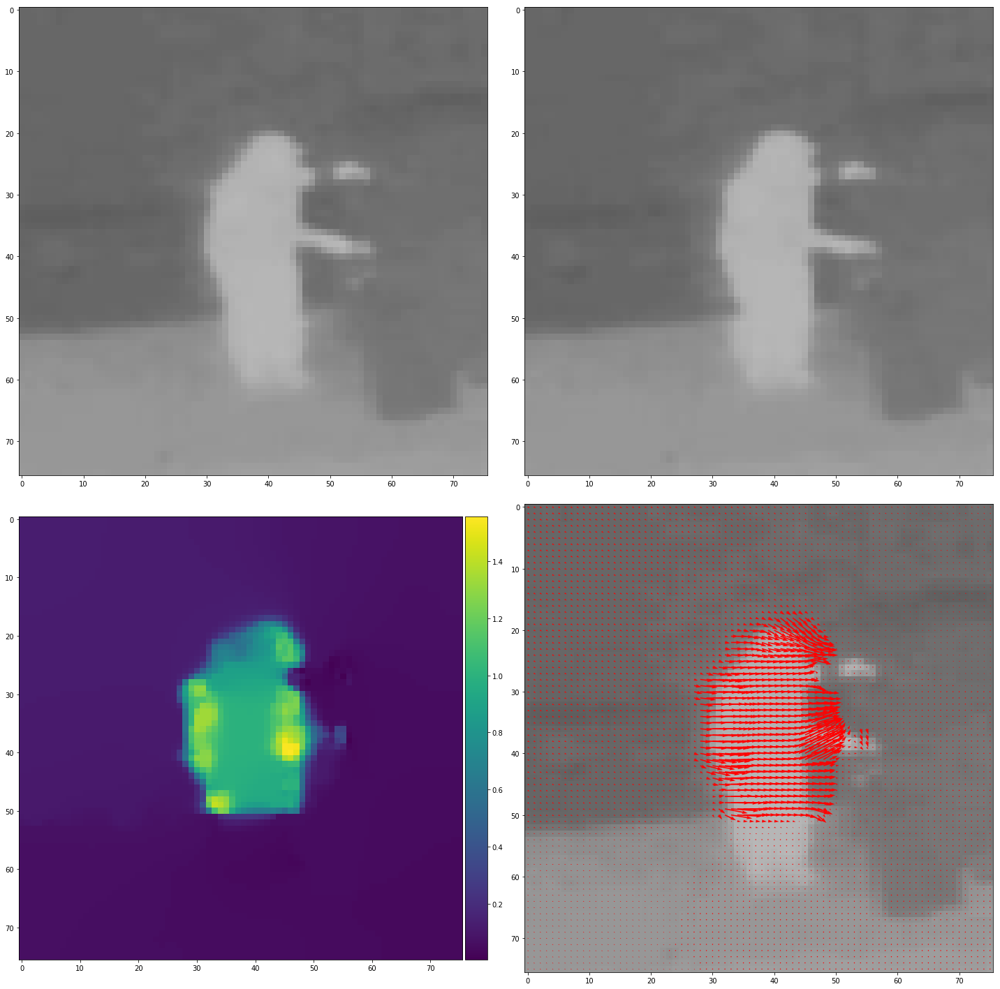

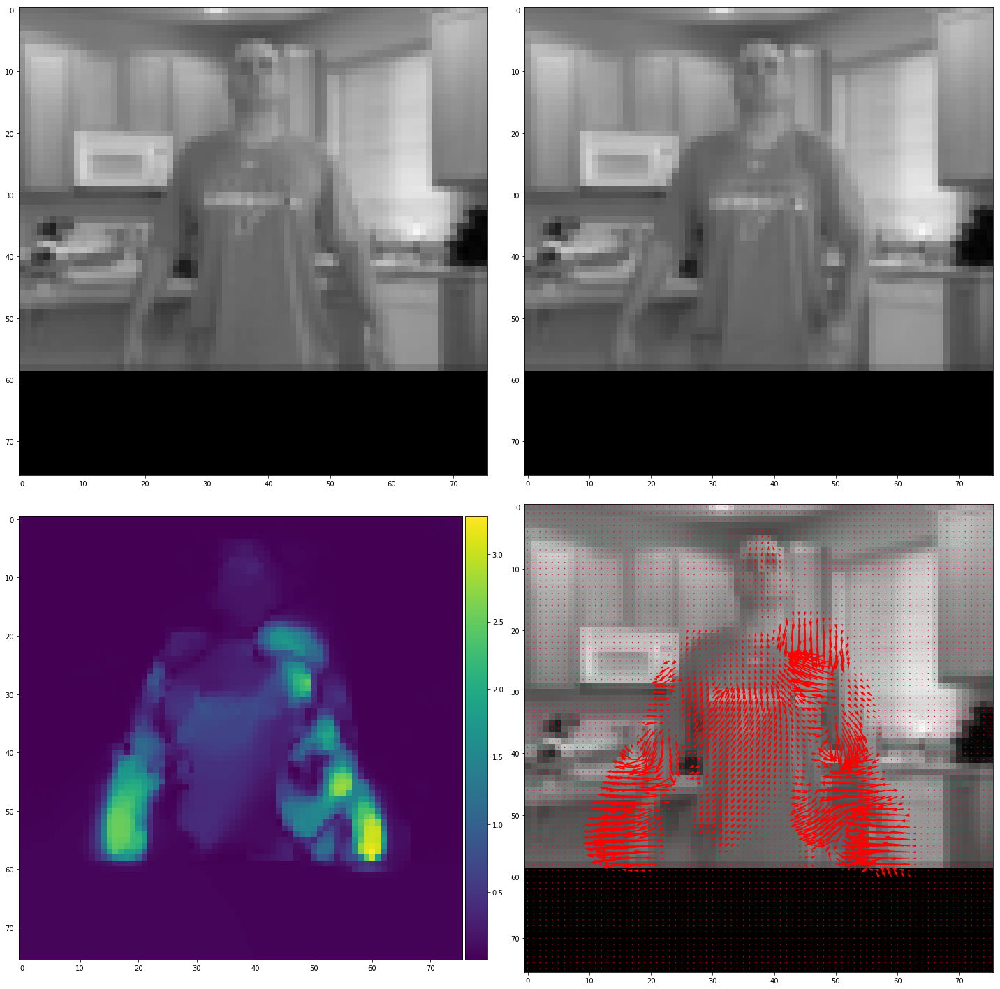

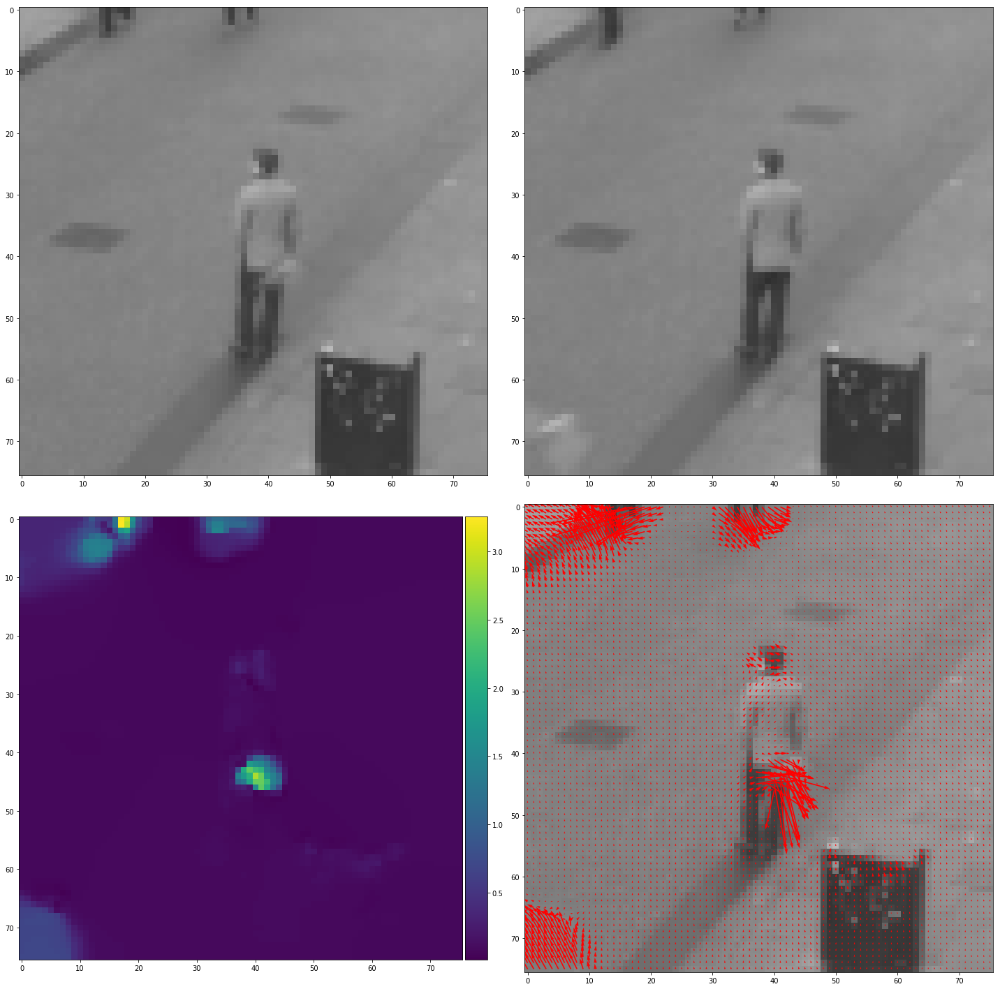

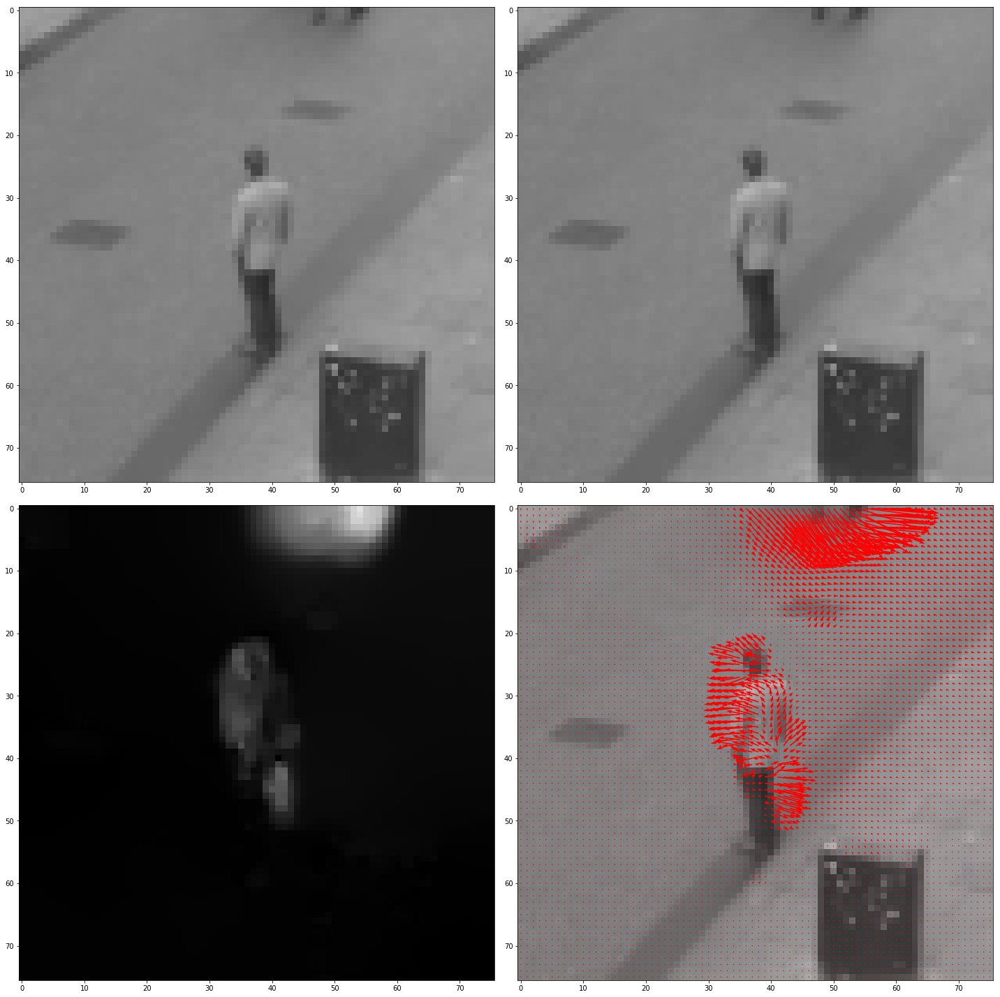

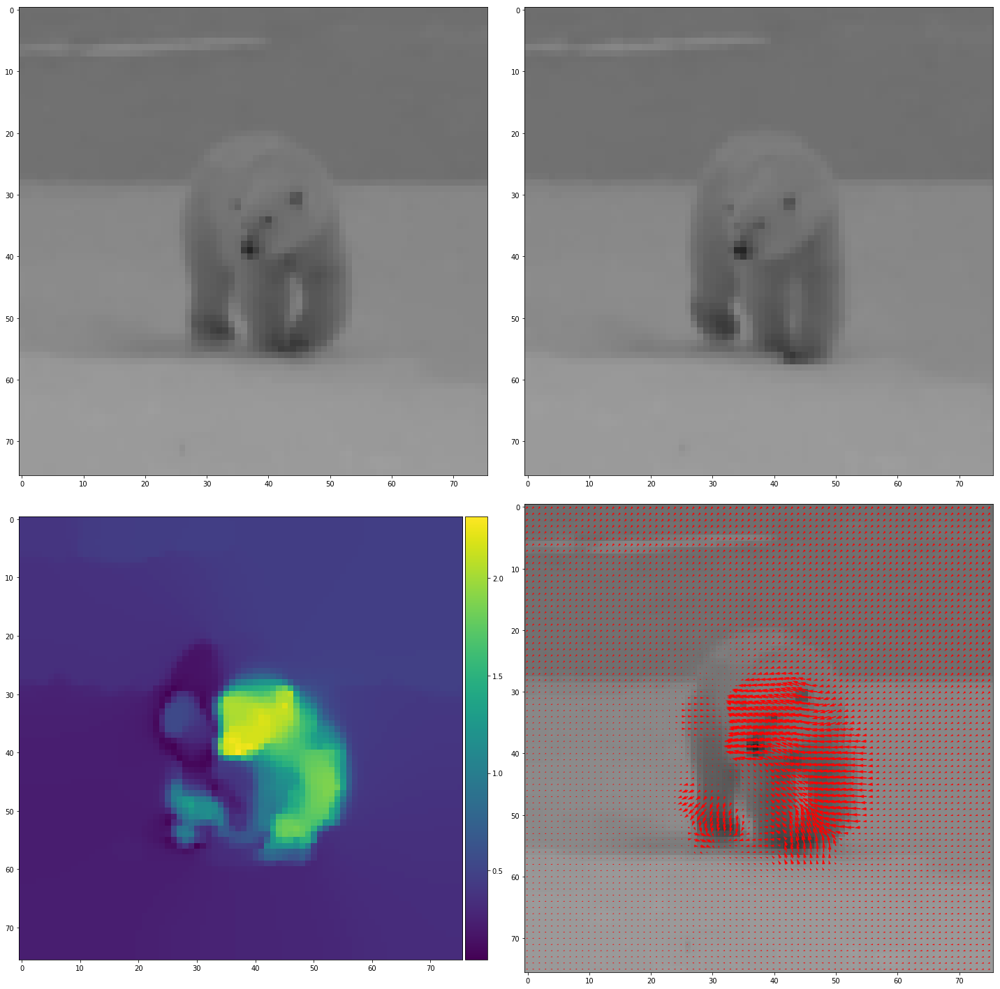

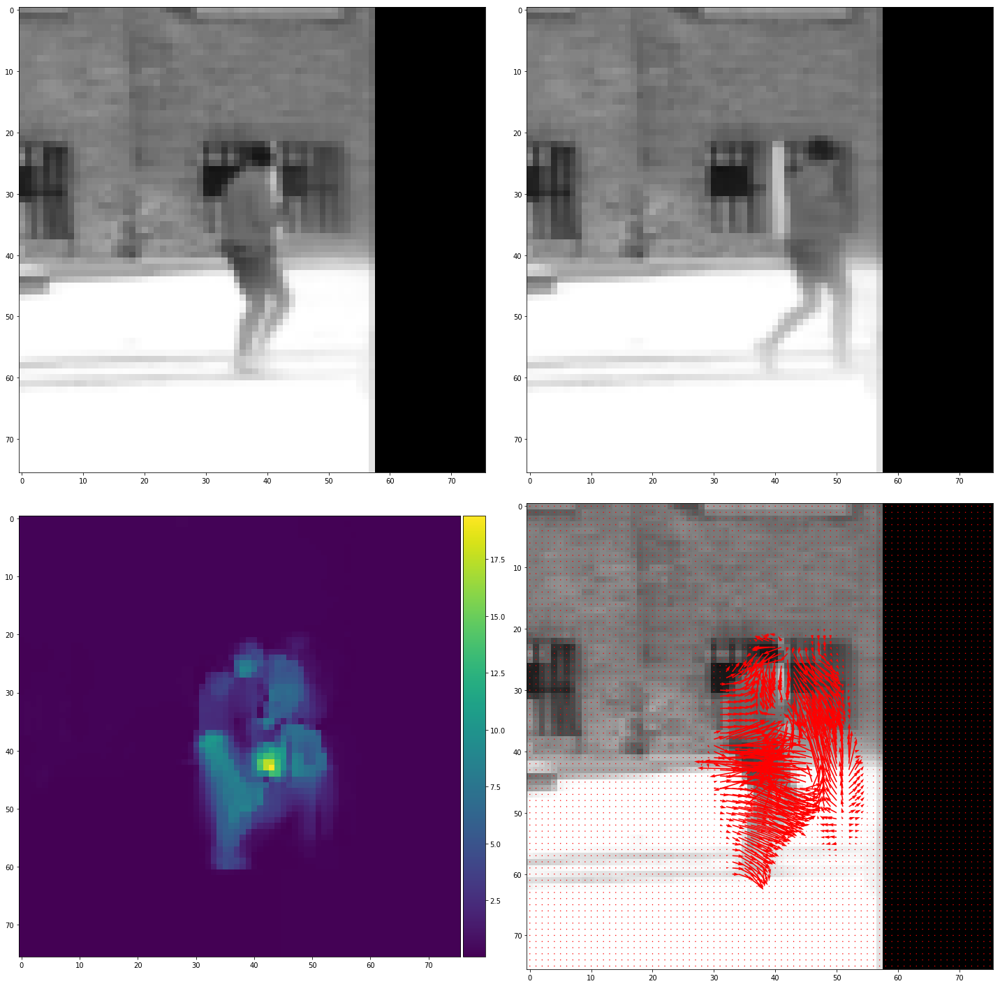

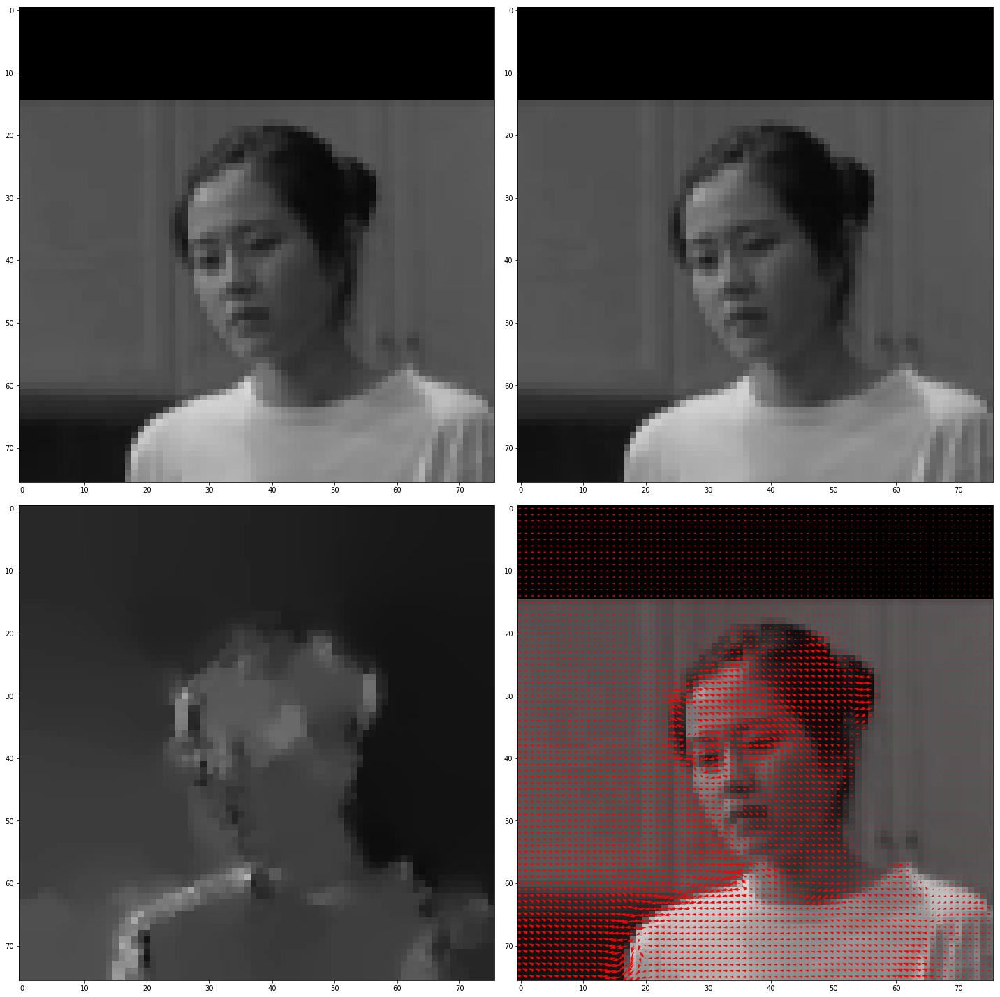

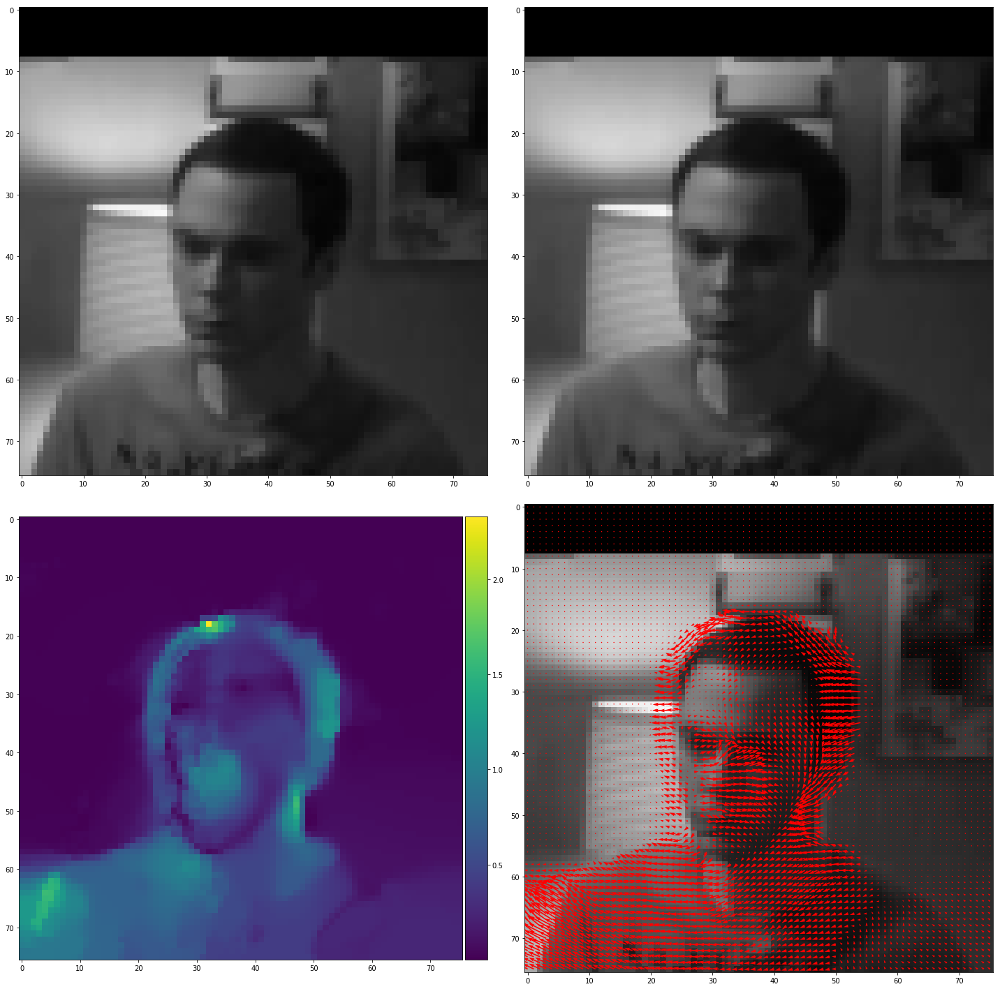

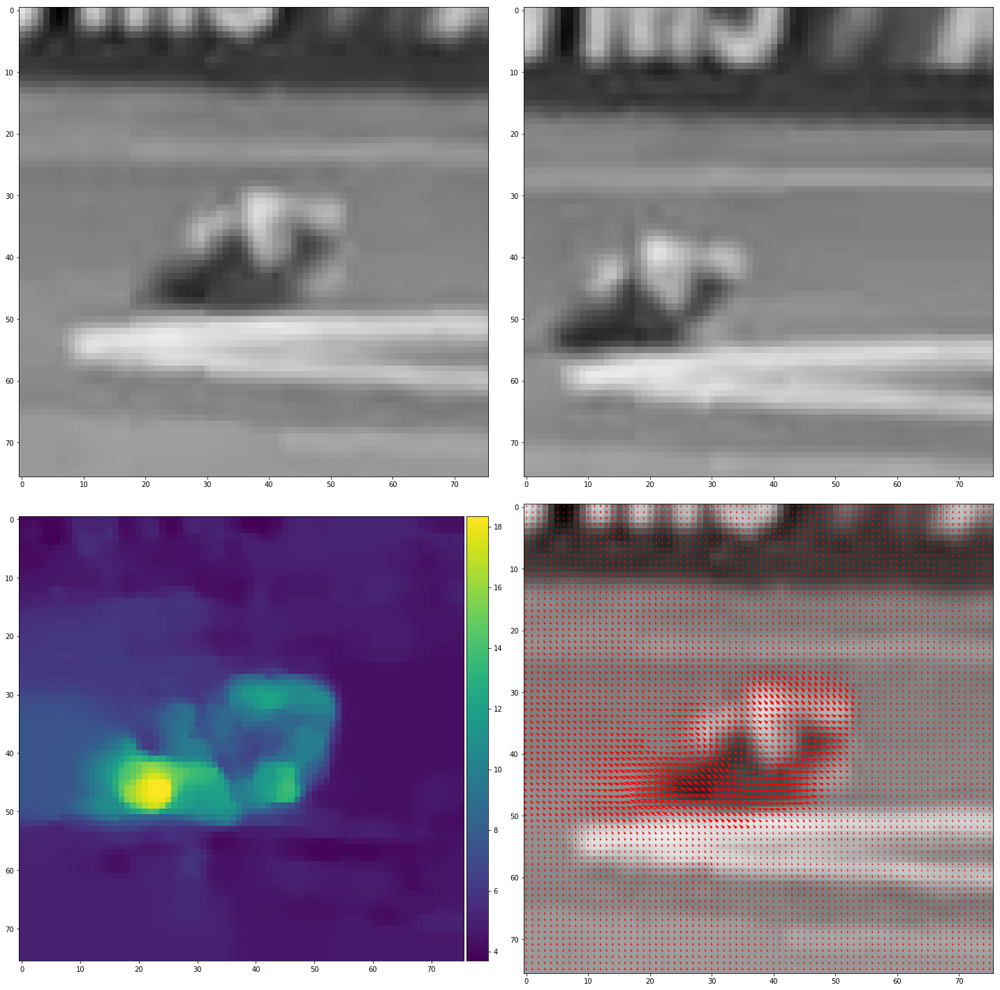

In [180]:
for _, r in df2.sort_values(by='v1_x_error', ascending=True).iloc[1:10].iterrows():
    plt.figure(figsize=(20, 20))
    
    f1_path = join(d, r['feature_dir'], 'prev_frame.png')
    f2_path = join(d, r['feature_dir'], 'frame.png')
    
    plt.subplot(2, 2, 1)
    prev_frame = io.imread(f1_path)
    io.imshow(prev_frame)
    
    plt.subplot(2, 2, 2)
    frame = io.imread(f2_path)
    io.imshow(frame)
    
    prev_frame_f = np.expand_dims(img_as_float(prev_frame), axis=2)
    frame_f = np.expand_dims(img_as_float(frame), axis=2)
    
    u, v, im2W = pyflow.coarse2fine_flow(
    prev_frame_f, frame_f, alpha, ratio, minWidth, nOuterFPIterations, nInnerFPIterations,
    nSORIterations, colType)
    
    plt.subplot(2, 2, 3)
    io.imshow(np.sqrt(np.square(u) + np.square(v)))
    
    plt.subplot(2, 2, 4)
    io.imshow(prev_frame)
    plt.quiver(u, v, color='r')
    
    plt.show()
    

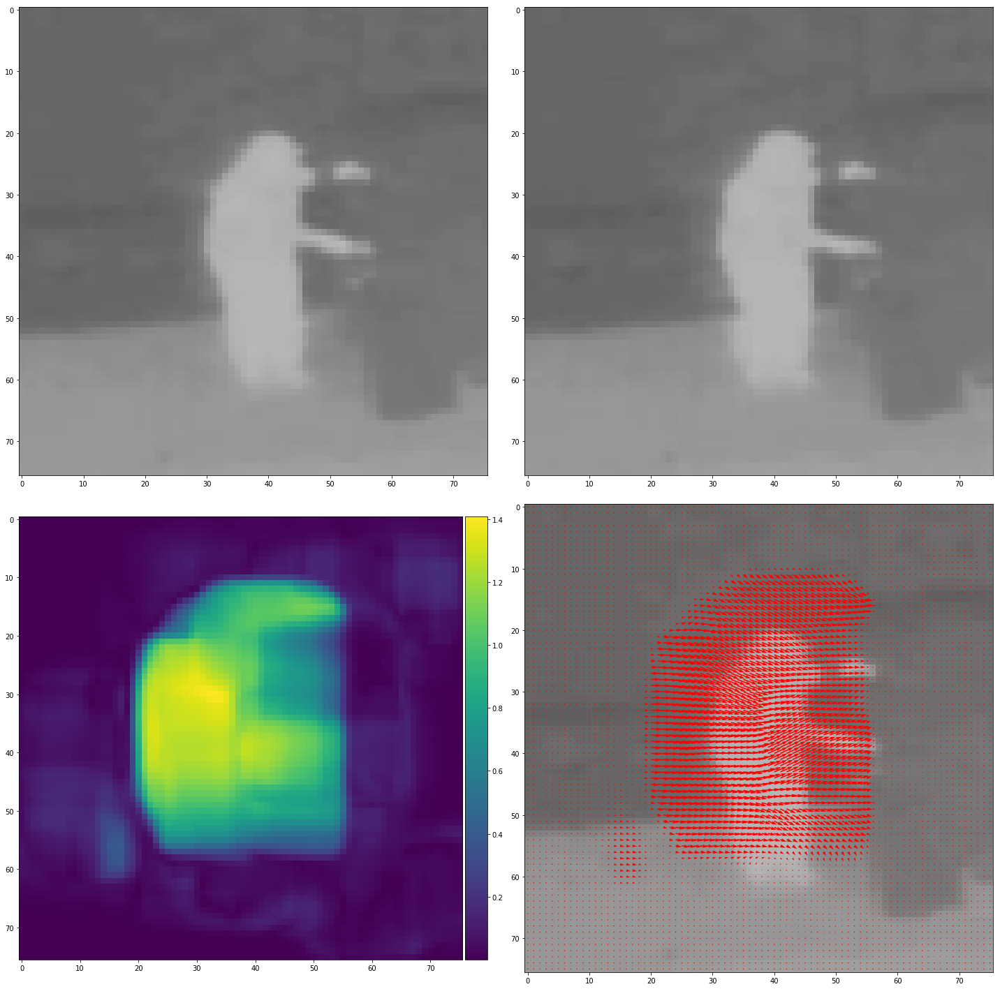

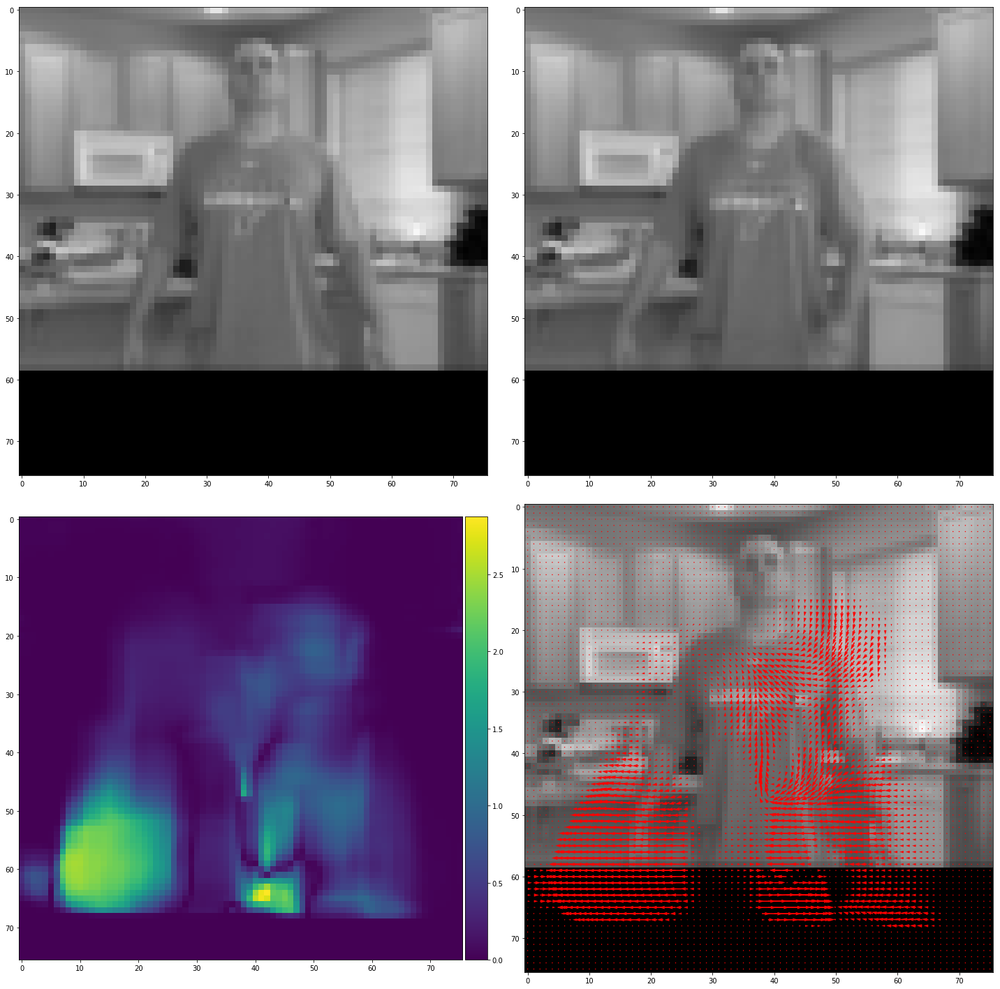

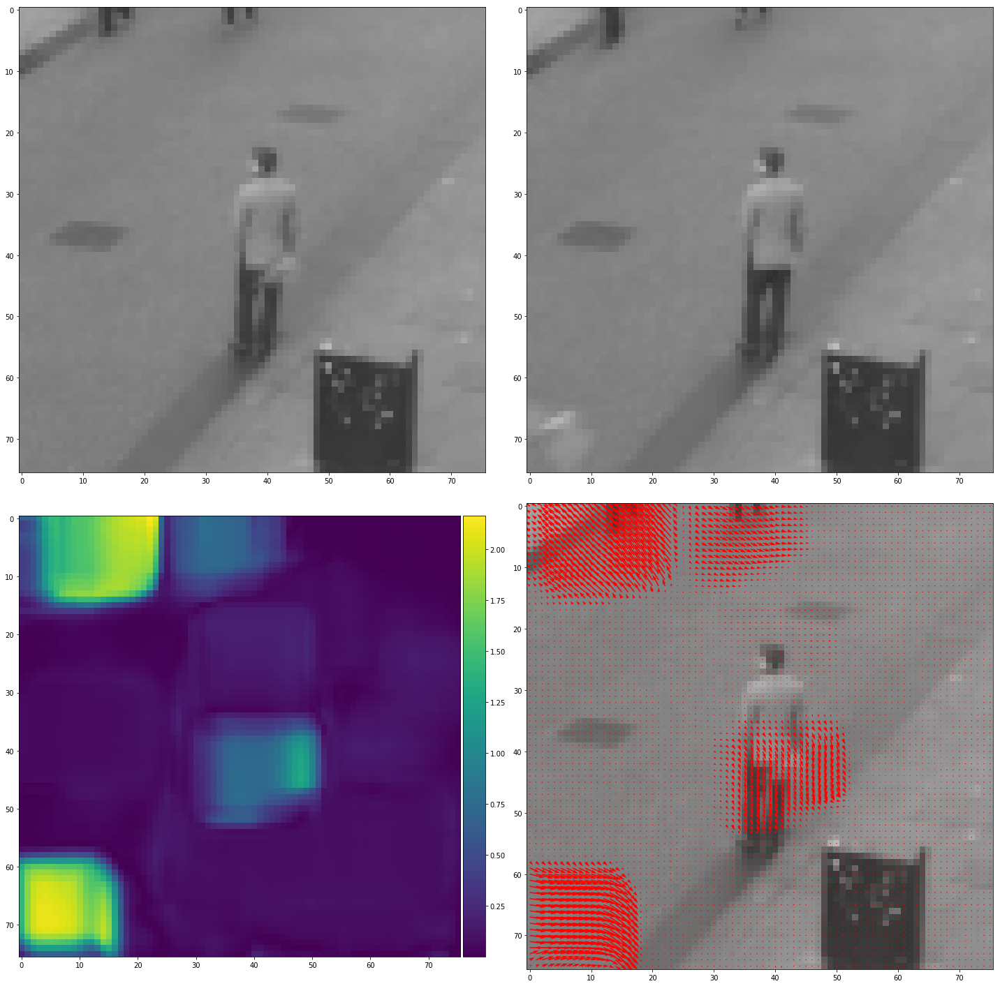

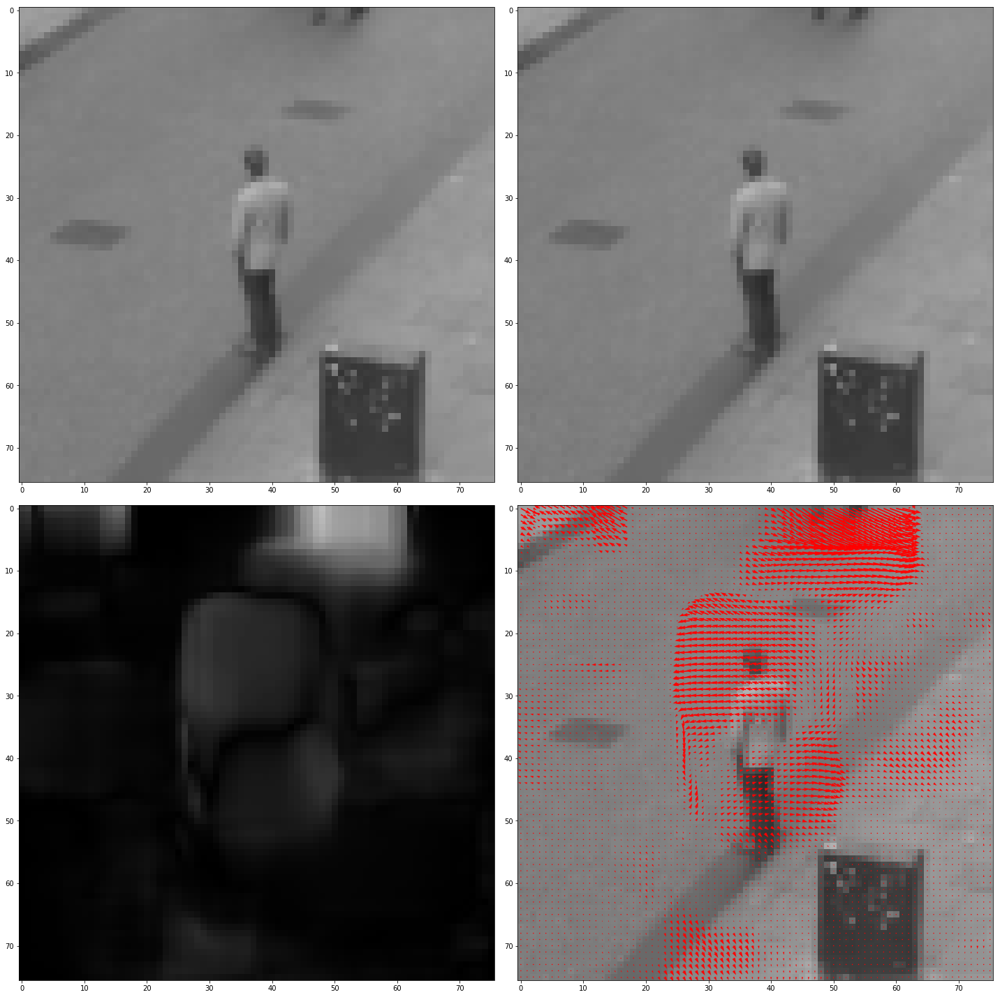

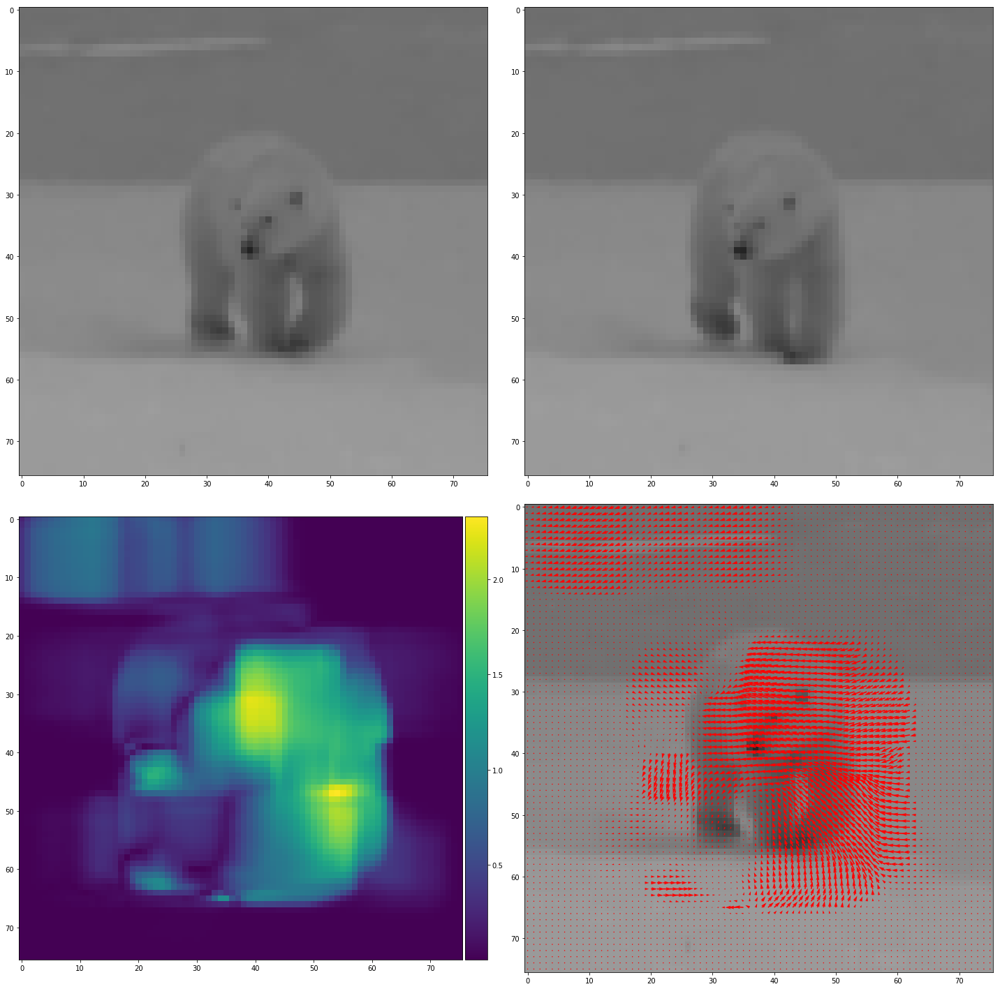

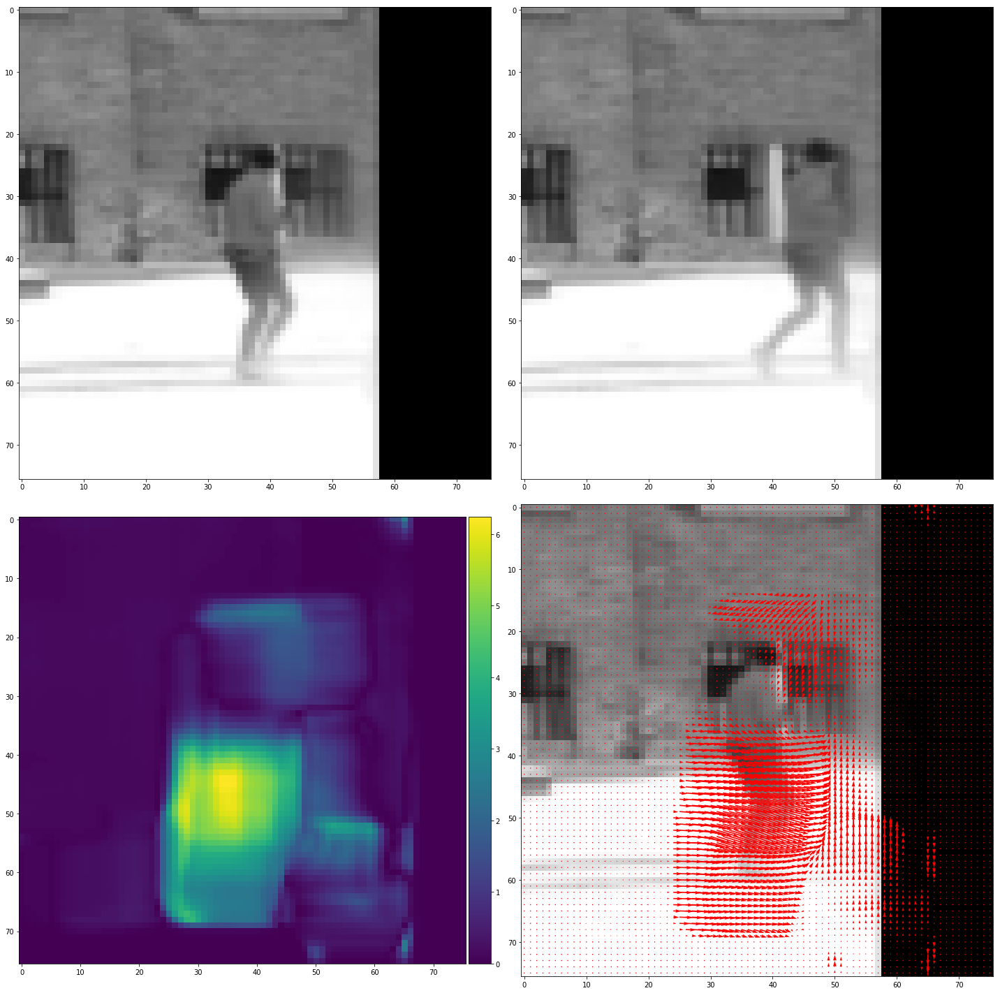

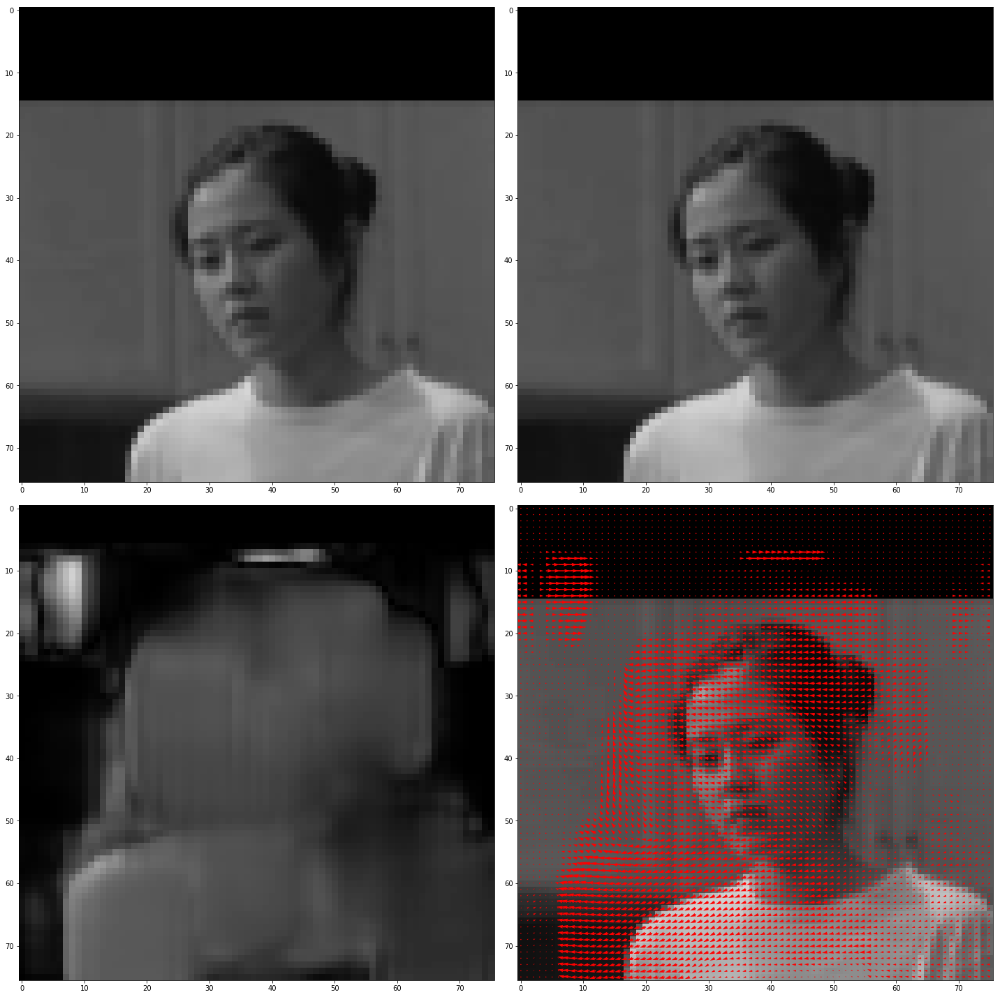

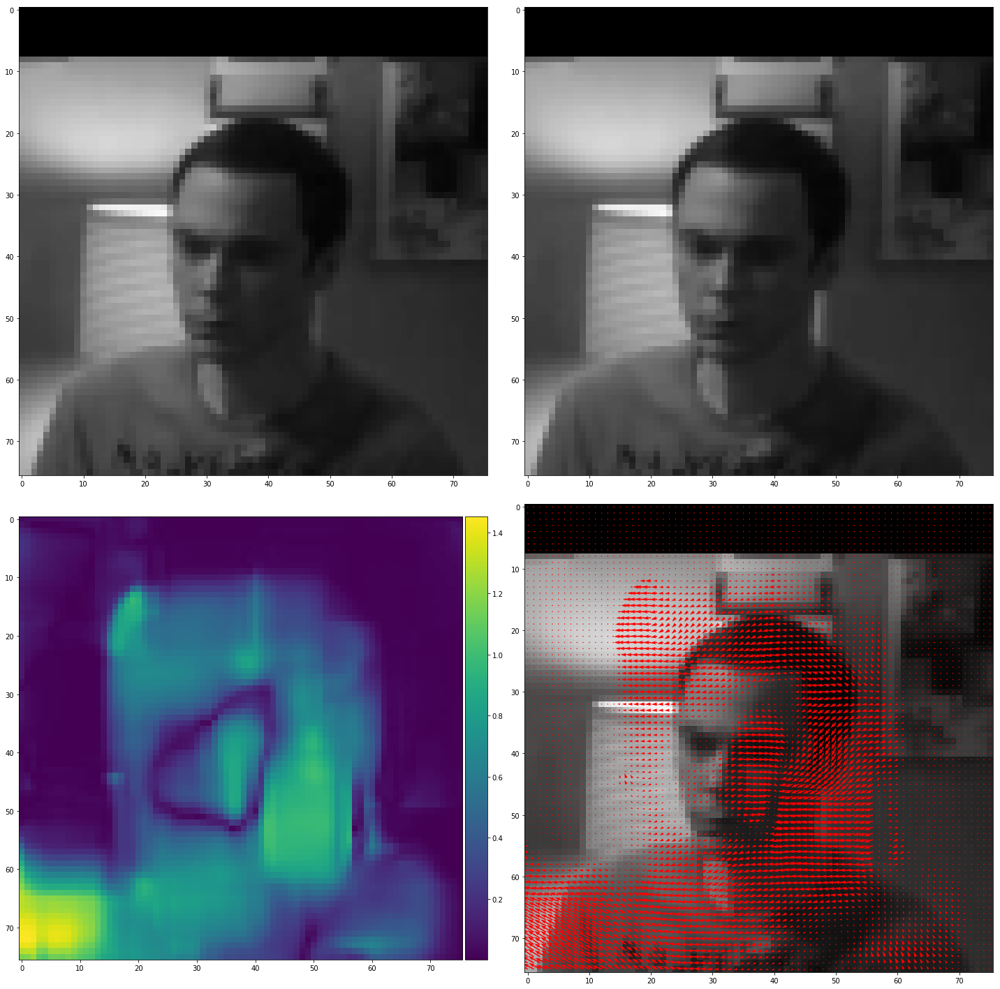

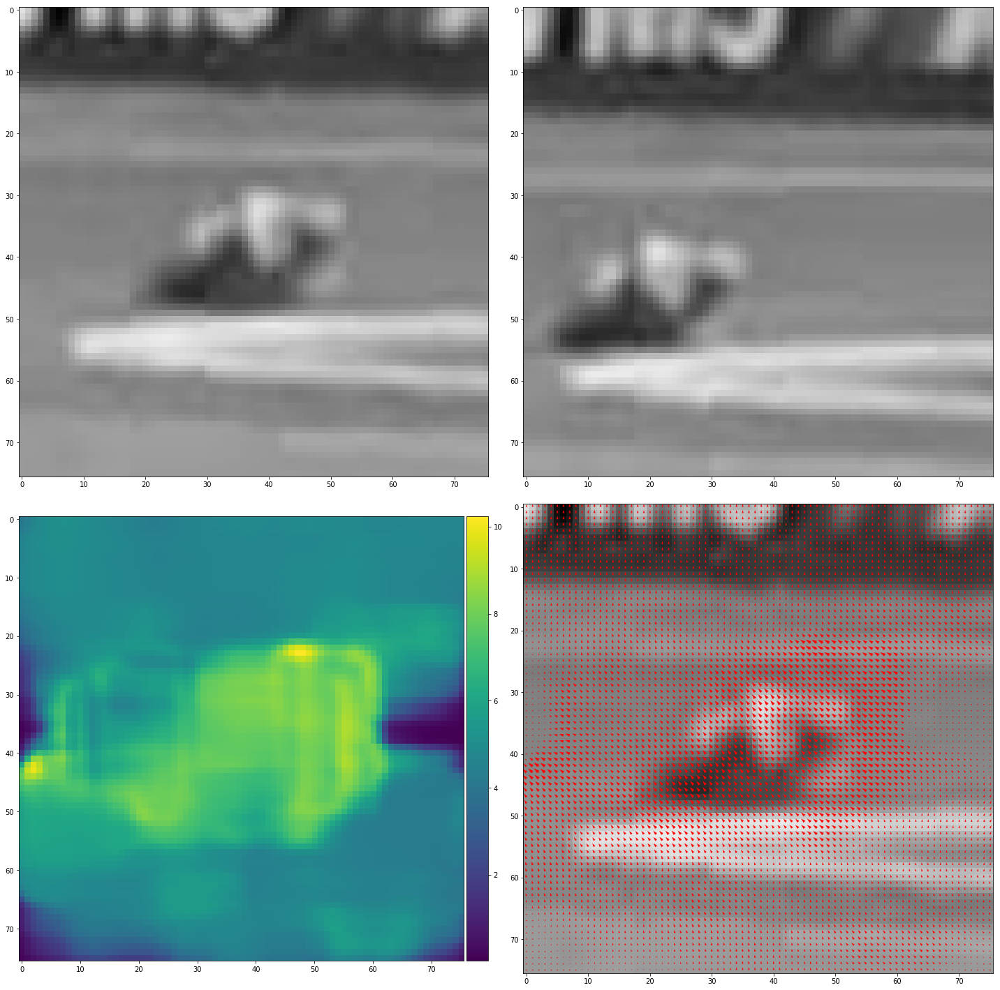

In [183]:
for _, r in df2.sort_values(by='v1_x_error', ascending=True).iloc[1:10].iterrows():
    plt.figure(figsize=(20, 20))
    
    f1_path = join(d, r['feature_dir'], 'prev_frame.png')
    f2_path = join(d, r['feature_dir'], 'frame.png')
    
    plt.subplot(2, 2, 1)
    prev_frame = io.imread(f1_path)
    io.imshow(prev_frame)
    
    plt.subplot(2, 2, 2)
    frame = io.imread(f2_path)
    io.imshow(frame)
    
    prev_frame_u8 = img_as_ubyte(prev_frame)
    frame_u8 = img_as_ubyte(frame)
    opt_flow_farneback = cv2.calcOpticalFlowFarneback(prev_frame_u8, frame_u8, flow=None, pyr_scale=0.5, levels=1, winsize=15, iterations=3, poly_n=5, poly_sigma=1.1, flags=0)
    v = opt_flow_farneback[:, :, 1]
    h = opt_flow_farneback[:, :, 0]
    
    plt.subplot(2, 2, 3)
    io.imshow(np.sqrt(np.square(h) + np.square(v)))
    
    plt.subplot(2, 2, 4)
    io.imshow(prev_frame)
    plt.quiver(h, v, color='r')
    
    plt.show()

In [18]:
d = '../data/alov300++/pairwise_test_frac1_size76_ratio0.5_grayscale'

cv_df = pd.read_json('../data/alov300++/pairwise_test_frac1_size76_ratio0.5_grayscale/index.json')



In [19]:
cv_df2 = cv_df.merge(cv_df.apply(flow_avg, axis=1), left_index=True, right_index=True)

In [20]:
p_offset = m.predict(cv_df2[['fx_in', 'fx_out', 'fy_in', 'fy_out']])

In [21]:
p_offset = np.reshape(p_offset, [2688, 2, 2])

In [22]:
box1 = np.stack(cv_df2['box1'].values, axis=0)

In [23]:
box1.shape

(2688, 2, 2)

In [24]:
p_box2 = box1 + p_offset

In [25]:
t_box2 = np.stack(cv_df2['box2'].values, axis=0)

In [26]:
np.mean(np.abs(p_box2 - t_box2)) / (76 - 1)

0.037579923692558338

In [27]:
(np.abs(p_box2 - t_box2))[:, 0, 0]

array([  0.69817547,   3.24225787,   0.48544304, ...,  18.00749287,
         2.58319363,   2.20074363])

In [28]:
np.abs(box2 - box1)[:, 0, 0]

NameError: name 'box2' is not defined

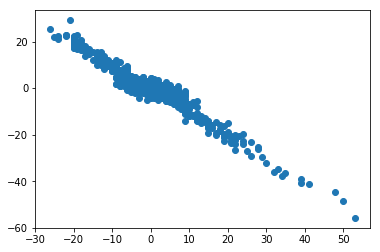

In [29]:
plt.scatter((t_box2 - box1)[:, 0, 0], (p_offset - t_box2 + box1)[:, 0, 0])

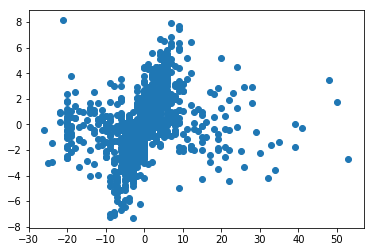

In [30]:
plt.scatter((t_box2 - box1)[:, 0, 0], p_offset[:, 0, 0])